# Import Libraries

In [ ]:
pip install catboost

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.7/98.7 MB 9.4 MB/s eta 0:00:00


In [ ]:
from google.colab import drive
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import silhouette_score
from sklearn.model_selection import train_test_split, cross_val_score, cross_validate
from sklearn.tree import DecisionTreeClassifier
from sklearn import metrics
from sklearn.tree import export_graphviz
from io import StringIO
from IPython.display import Image
import pydotplus
from sklearn.metrics import classification_report, confusion_matrix, mean_squared_error
import itertools
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import SMOTE
from sklearn.linear_model import LinearRegression, Ridge, RidgeCV, Lasso
from sklearn.feature_selection import SequentialFeatureSelector
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.neural_network import MLPRegressor
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from catboost import CatBoostRegressor
from sklearn.metrics import f1_score, recall_score, make_scorer
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression, SGDClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import GradientBoostingClassifier, AdaBoostClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
from sklearn.pipeline import Pipeline,make_pipeline
from sklearn import set_config
from imblearn.pipeline import Pipeline as imbpipeline
import pickle
%matplotlib inline

# Load Data

In [ ]:
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
os.chdir('/content/drive/MyDrive/data_challenge')

In [ ]:
df = pd.read_excel('Telco_customer_churn_adapted_v2.xlsx')
df.head()

,Customer ID,Tenure Months,Location,Device Class,Games Product,Music Product,Education Product,Call Center,Video Product,Use MyApp,Payment Method,Monthly Purchase (Thou. IDR),Churn Label,Longitude,Latitude,CLTV (Predicted Thou. IDR)
0,0,2,Jakarta,Mid End,Yes,Yes,No,No,No,No,Digital Wallet,70.005,Yes,106.816666,-6.2,4210.7
1,1,2,Jakarta,High End,No,No,No,No,No,No,Pulsa,91.910,Yes,106.816666,-6.2,3511.3
2,2,8,Jakarta,High End,No,No,Yes,No,Yes,Yes,Pulsa,129.545,Yes,106.816666,-6.2,6983.6
3,3,28,Jakarta,High End,No,No,Yes,Yes,Yes,Yes,Pulsa,136.240,Yes,106.816666,-6.2,6503.9
4,4,49,Jakarta,High End,No,Yes,Yes,No,Yes,Yes,Debit,134.810,Yes,106.816666,-6.2,6942.0


# Data Exploration

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7043 entries, 0 to 7042
Data columns (total 16 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Customer ID                   7043 non-null   int64  
 1   Tenure Months                 7043 non-null   int64  
 2   Location                      7043 non-null   object 
 3   Device Class                  7043 non-null   object 
 4   Games Product                 7043 non-null   object 
 5   Music Product                 7043 non-null   object 
 6   Education Product             7043 non-null   object 
 7   Call Center                   7043 non-null   object 
 8   Video Product                 7043 non-null   object 
 9   Use MyApp                     7043 non-null   object 
 10  Payment Method                7043 non-null   object 
 11  Monthly Purchase (Thou. IDR)  7043 non-null   float64
 12  Churn Label                   7043 non-null   object 
 13  Lon

In [ ]:
df.isnull().sum()

Customer ID                     0
Tenure Months                   0
Location                        0
Device Class                    0
Games Product                   0
Music Product                   0
Education Product               0
Call Center                     0
Video Product                   0
Use MyApp                       0
Payment Method                  0
Monthly Purchase (Thou. IDR)    0
Churn Label                     0
Longitude                       0
Latitude                        0
CLTV (Predicted Thou. IDR)      0
dtype: int64

In [ ]:
df['Customer ID'].nunique()

7043

In [ ]:
df = df.drop(columns=['Longitude', 'Latitude']) #Longitude & Latitude tidak penting
                                                #Longitude 106.8167, Latitude -6.2 = Jakarta Location
                                                #Longitude 107.6098, Latitude -6.9147 = Bandung Location

In [ ]:
df

,Customer ID,Tenure Months,Location,Device Class,Games Product,Music Product,Education Product,Call Center,Video Product,Use MyApp,Payment Method,Monthly Purchase (Thou. IDR),Churn Label,CLTV (Predicted Thou. IDR)
0,0,2,Jakarta,Mid End,Yes,Yes,No,No,No,No,Digital Wallet,70.005,Yes,4210.7
1,1,2,Jakarta,High End,No,No,No,No,No,No,Pulsa,91.910,Yes,3511.3
2,2,8,Jakarta,High End,No,No,Yes,No,Yes,Yes,Pulsa,129.545,Yes,6983.6
3,3,28,Jakarta,High End,No,No,Yes,Yes,Yes,Yes,Pulsa,136.240,Yes,6503.9
4,4,49,Jakarta,High End,No,Yes,Yes,No,Yes,Yes,Debit,134.810,Yes,6942.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7038,7038,72,Jakarta,Low End,No internet service,No internet service,No internet service,No,No internet service,No internet service,Debit,27.495,No,6897.8
7039,7039,24,Jakarta,Mid End,Yes,No,Yes,Yes,Yes,Yes,Digital Wallet,110.240,No,2782.0
7040,7040,72,Jakarta,High End,No,Yes,Yes,No,Yes,Yes,Credit,134.160,No,7228.0
7041,7041,11,Jakarta,Mid End,Yes,No,No,No,No,No,Pulsa,38.480,No,3630.9


In [ ]:
df['Tenure Months'].median()

29.0

In [ ]:
df['Monthly Purchase (Thou. IDR)'].median()

91.455

In [ ]:
df['CLTV (Predicted Thou. IDR)'].median()

5885.1

In [ ]:
df['Tenure Months'].mean()

32.37114865824223

In [ ]:
df2 = df.copy()
df2 = df2[df2['Location'] == 'Jakarta']
df2['Tenure Months'].mean()

32.595507851321806

In [ ]:
df2['Tenure Months'].median()

29.0

In [ ]:
df3 = df.copy()
df3 = df3[df3['Location'] == 'Bandung']
df3['Tenure Months'].mean()

31.81013916500994

In [ ]:
df3['Tenure Months'].median()

29.0

In [ ]:
df2 = df.copy()
df2 = df2[df2['Call Center'] == 'Yes']
df2['CLTV (Predicted Thou. IDR)'].mean()

6006.899951076321

In [ ]:
df2['CLTV (Predicted Thou. IDR)'].median()

6162.0

In [ ]:
df3 = df.copy()
df3 = df3[df3['Call Center'] == 'No']
df3['CLTV (Predicted Thou. IDR)'].mean()

5603.233526705341

In [ ]:
df3['CLTV (Predicted Thou. IDR)'].median()

5770.7

# Data Visualization

In [ ]:
df2 = df.copy()
df2["Tenure Months"] = df2["Tenure Months"]//10*10+10

<Axes: xlabel='Tenure Months', ylabel='count'>

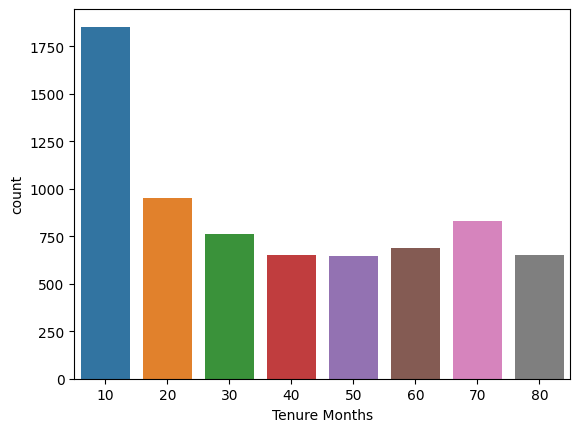

In [ ]:
sns.countplot(data=df2, x="Tenure Months")

<Axes: xlabel='Location', ylabel='count'>

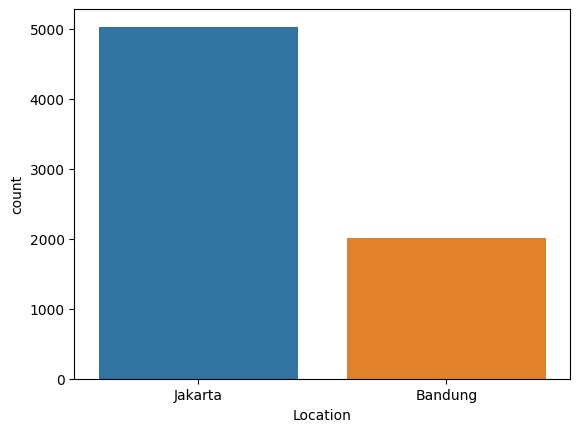

In [ ]:
sns.countplot(data=df, x="Location")

<Axes: xlabel='Device Class', ylabel='count'>

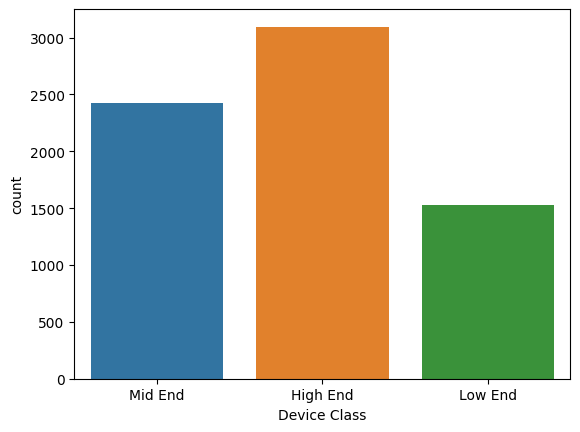

In [ ]:
sns.countplot(data=df, x="Device Class")

<Axes: xlabel='Games Product', ylabel='count'>

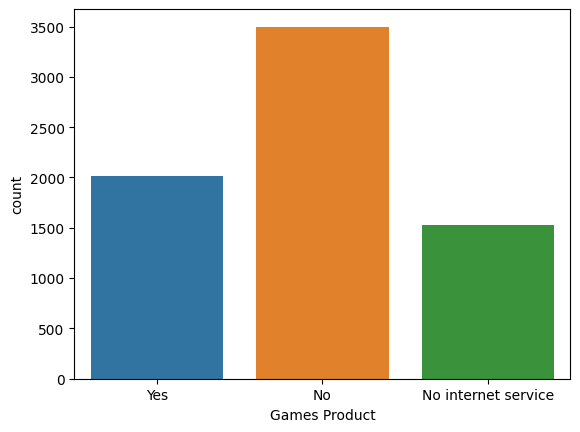

In [ ]:
sns.countplot(data=df, x="Games Product")

<Axes: xlabel='Music Product', ylabel='count'>

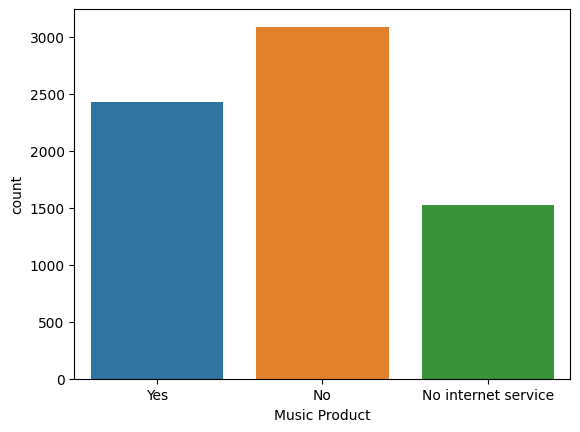

In [ ]:
sns.countplot(data=df, x="Music Product")

<Axes: xlabel='Education Product', ylabel='count'>

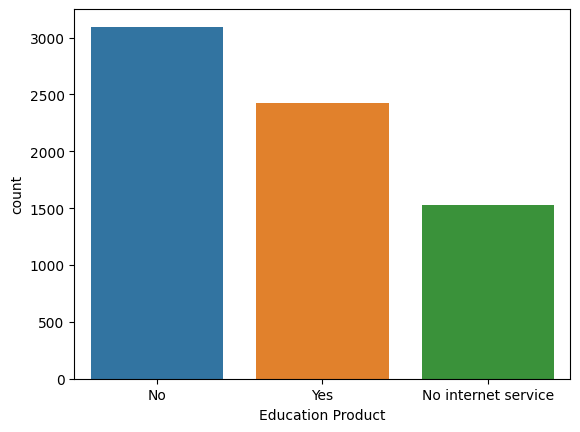

In [ ]:
sns.countplot(data=df, x="Education Product")

<Axes: xlabel='Call Center', ylabel='count'>

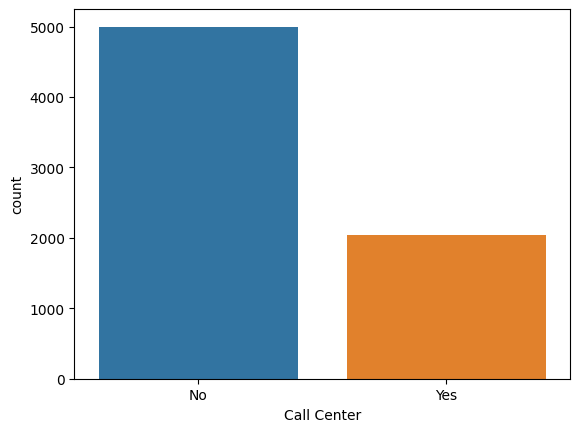

In [ ]:
sns.countplot(data=df, x="Call Center")

<Axes: xlabel='Video Product', ylabel='count'>

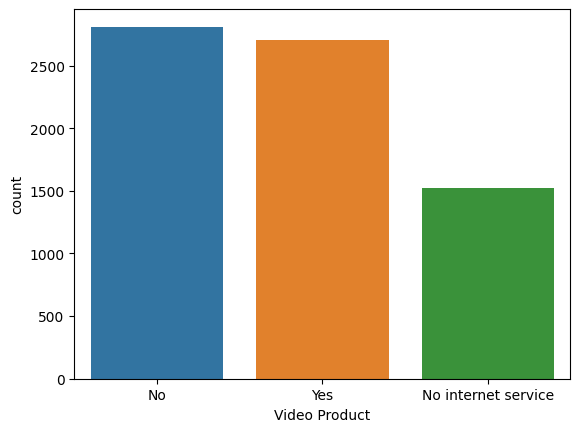

In [ ]:
sns.countplot(data=df, x="Video Product")

<Axes: xlabel='Use MyApp', ylabel='count'>

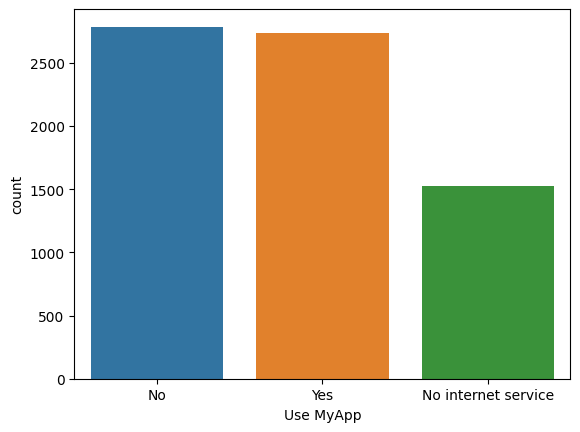

In [ ]:
sns.countplot(data=df, x="Use MyApp")

<Axes: xlabel='Payment Method', ylabel='count'>

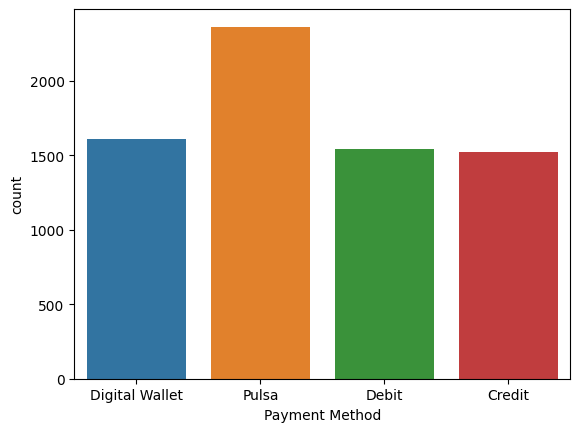

In [ ]:
sns.countplot(data=df, x="Payment Method")

In [ ]:
df3 = df.copy()
df3["Monthly Purchase (Thou. IDR)"] = df3["Monthly Purchase (Thou. IDR)"]//20*20+20

<Axes: xlabel='Monthly Purchase (Thou. IDR)', ylabel='count'>

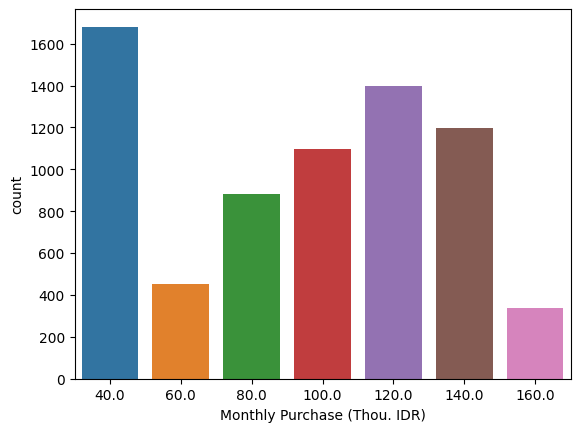

In [ ]:
sns.countplot(data=df3, x="Monthly Purchase (Thou. IDR)")

<Axes: xlabel='Churn Label', ylabel='count'>

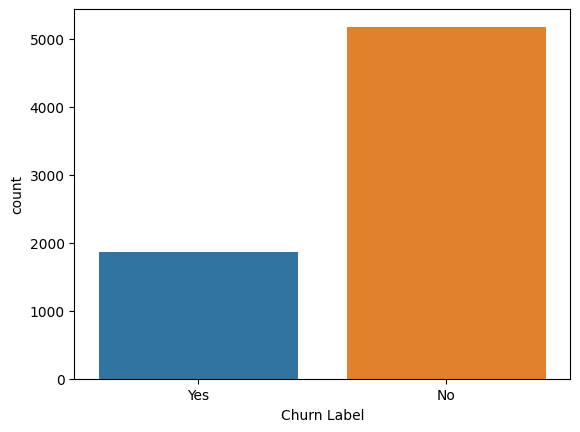

In [ ]:
sns.countplot(data=df, x="Churn Label")

In [ ]:
#sns.countplot(data=df, x="Longitude") #Longitude & Latitude tidak penting
                                      #Longitude 106.8167, Latitude -6.2 = Jakarta Location
                                      #Longitude 107.6098, Latitude -6.9147 = Bandung Location

In [ ]:
#sns.countplot(data=df, x="Latitude")  #Longitude & Latitude tidak penting
                                      #Longitude 106.8167, Latitude -6.2 = Jakarta Location
                                      #Longitude 107.6098, Latitude -6.9147 = Bandung Location

In [ ]:
df4 = df.copy()
df4["CLTV (Predicted Thou. IDR)"] = df4["CLTV (Predicted Thou. IDR)"]//1000*1000+1000

<Axes: xlabel='CLTV (Predicted Thou. IDR)', ylabel='count'>

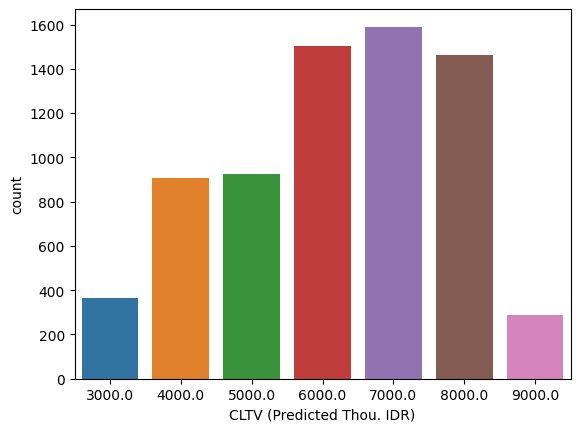

In [ ]:
sns.countplot(data=df4, x="CLTV (Predicted Thou. IDR)")

In [ ]:
df5 = df.copy()
df5['Total Purchase'] = df5['Monthly Purchase (Thou. IDR)'] * df5['Tenure Months']
df5["Total Purchase"] = df5["Total Purchase"]//1000*1000+1000

In [ ]:
df5["Total Purchase"] = df5["Total Purchase"].astype(int)

<Axes: xlabel='Total Purchase', ylabel='count'>

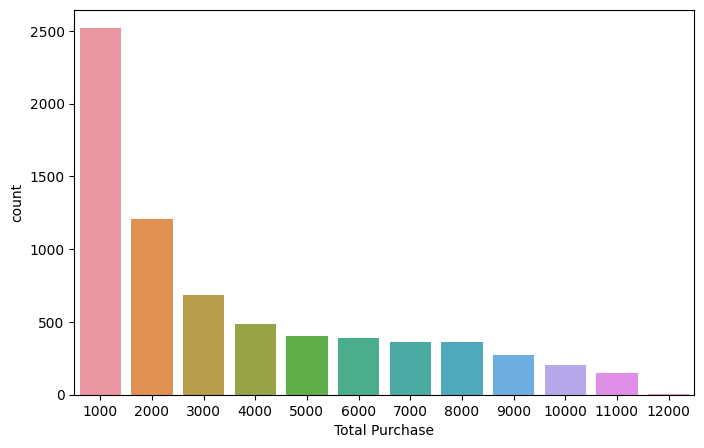

In [ ]:
plt.figure(figsize=(8, 5))
sns.countplot(data=df5, x="Total Purchase")

In [ ]:
correlation_matrix = df[["Tenure Months","Monthly Purchase (Thou. IDR)","CLTV (Predicted Thou. IDR)"]].corr()

<Axes: >

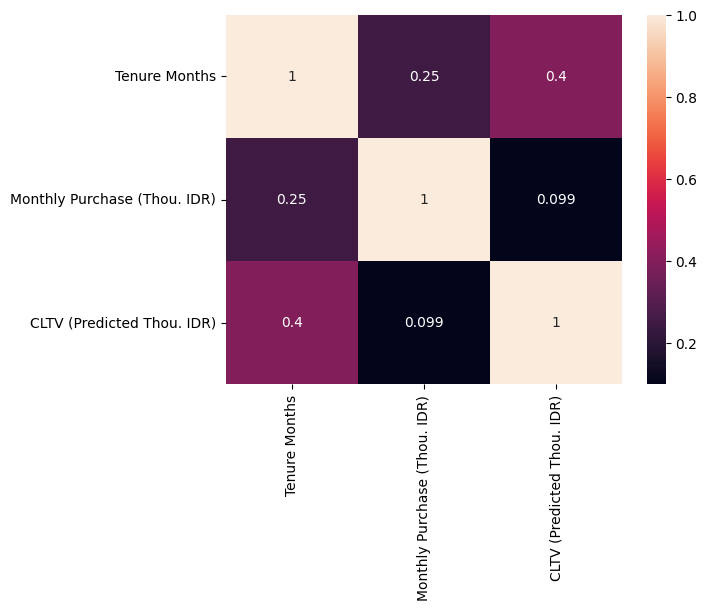

In [ ]:
sns.heatmap(correlation_matrix, annot=True)

In [ ]:
df2 = df.copy()
df2 = df2.drop(columns=['Customer ID'])
#df2 = df2[df2['Games Product'] != 'No Internet Service']
df2[['Games Product','Music Product','Education Product','Call Center','Video Product','Use MyApp','Churn Label']] = (df2[['Games Product','Music Product','Education Product','Call Center','Video Product','Use MyApp','Churn Label']] == 'Yes').astype(int)
df2['Location'] = (df2['Location'] == 'Jakarta').astype(int)
df2['Device Class'] = (df2['Device Class'] == 'High End').astype(int)
df2 = pd.get_dummies(df2, columns=['Payment Method'])

In [ ]:
correlation_matrix = df2.corr()

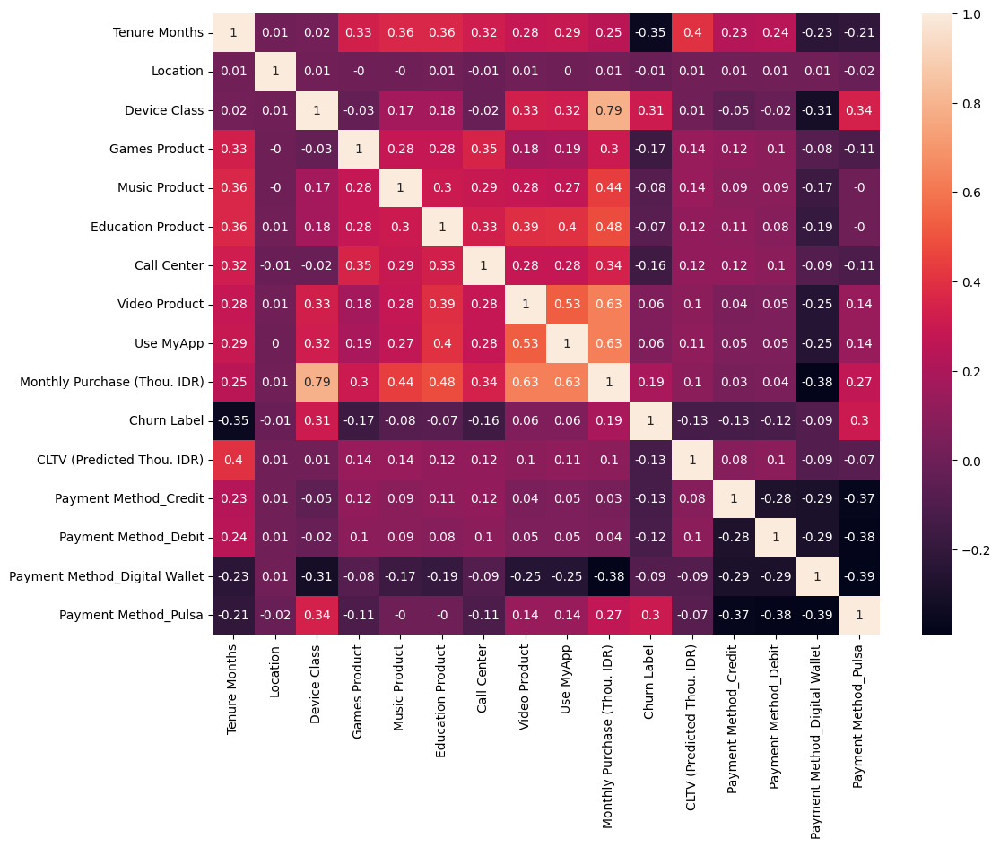

In [ ]:
plt.figure(figsize=(12, 9))
sns.heatmap(correlation_matrix.round(2), annot=True)
plt.show()

<Axes: >

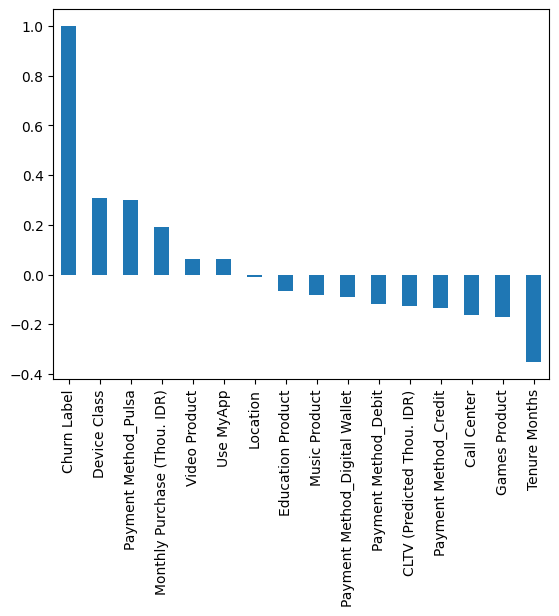

In [ ]:
df2.corr()['Churn Label'].sort_values(ascending = False).plot(kind='bar')

<Axes: xlabel='Churn Label', ylabel='Tenure Months'>

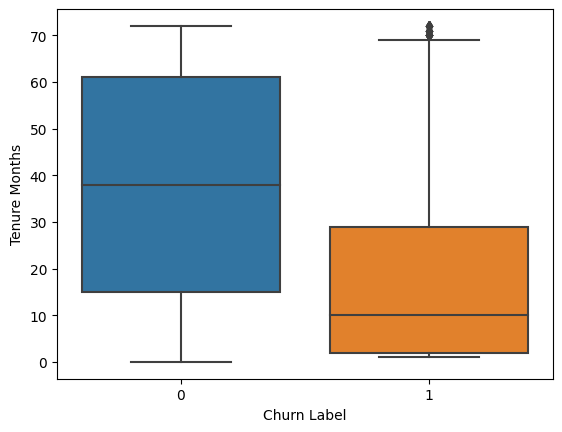

In [ ]:
sns.boxplot(x = df2['Churn Label'], y = df2['Tenure Months'])

In [ ]:
df3 = df2[df2['Churn Label'] == 1]
Q1 = df3['Tenure Months'].quantile(0.25)
Q3 = df3['Tenure Months'].quantile(0.75)
IQR = Q3 - Q1
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR
outliers = df3[(df3['Tenure Months'] < lower_bound) | (df3['Tenure Months'] > upper_bound)]
outliers

,Tenure Months,Location,Device Class,Games Product,Music Product,Education Product,Call Center,Video Product,Use MyApp,Monthly Purchase (Thou. IDR),Churn Label,CLTV (Predicted Thou. IDR),Payment Method_Credit,Payment Method_Debit,Payment Method_Digital Wallet,Payment Method_Pulsa
202,70,1,1,1,0,0,1,1,1,135.200,1,5907.2,1,0,0,0
248,71,0,1,1,0,1,1,1,1,140.465,1,6760.0,0,0,0,1
339,70,1,1,1,1,1,1,1,1,150.215,1,6289.4,1,0,0,0
751,70,1,1,0,1,1,0,1,1,133.835,1,6506.5,0,0,0,1
793,71,1,1,0,1,1,1,1,1,141.180,1,6476.6,1,0,0,0
815,72,1,1,0,1,1,0,1,1,134.420,1,6571.5,0,0,0,1
901,72,1,1,0,1,1,0,1,1,135.395,1,7702.5,0,1,0,0
916,70,0,1,1,1,1,1,1,1,142.350,1,7976.8,0,1,0,0
1026,72,1,1,0,1,1,1,1,1,142.025,1,5539.3,0,0,0,1
1091,71,1,0,0,1,0,0,1,1,64.155,1,6342.7,0,0,0,1


In [ ]:
y = df['CLTV (Predicted Thou. IDR)']
x = df['Monthly Purchase (Thou. IDR)']

plt.scatter(x, y)
plt.show()

# Churn Exploration

In [ ]:
df2 = df.copy()
df2 = df2[df2['Games Product'] == 'Yes']
sns.countplot(data=df2, x="Churn Label")

In [ ]:
df3 = df.copy()
df3 = df3[df3['Games Product'] == 'No']
sns.countplot(data=df3, x="Churn Label")

In [ ]:
df2 = df.copy()
df2 = df2[df2['Location'] == 'Jakarta']
sns.countplot(data=df2, x="Churn Label")

<Axes: xlabel='Churn Label', ylabel='count'>

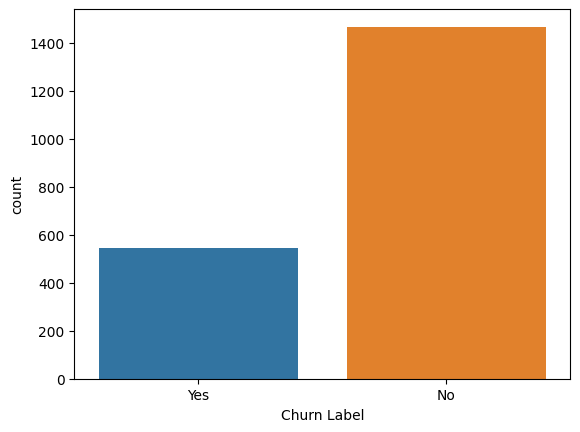

In [ ]:
df3 = df.copy()
df3 = df3[df3['Location'] == 'Bandung']
sns.countplot(data=df3, x="Churn Label")

## Churn Customers

In [ ]:
df = pd.read_excel('Telco_customer_churn_adapted_v2.xlsx')
df = df.drop(columns=['Longitude', 'Latitude', 'Customer ID'])
df = df[df['Churn Label'] == 'Yes']

In [ ]:
df2 = df.copy()
df2["Tenure Months"] = df2["Tenure Months"]//10*10+10

<Axes: xlabel='Tenure Months', ylabel='count'>

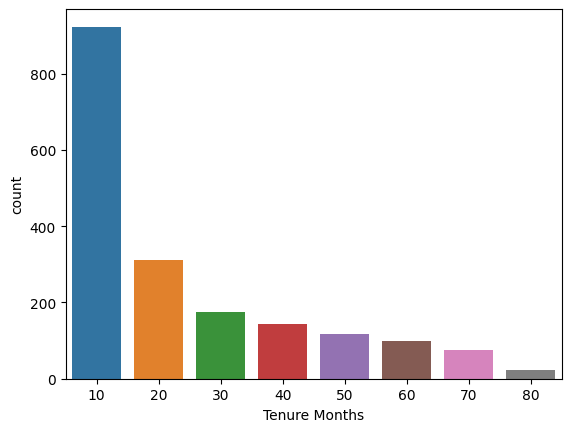

In [ ]:
sns.countplot(data=df2, x="Tenure Months")

<Axes: xlabel='Location', ylabel='count'>

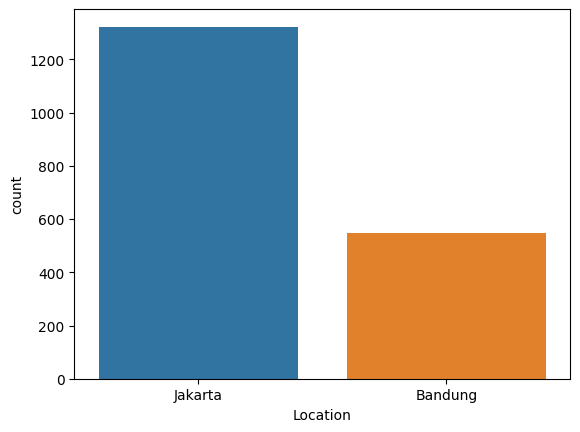

In [ ]:
sns.countplot(data=df, x="Location")

<Axes: xlabel='Device Class', ylabel='count'>

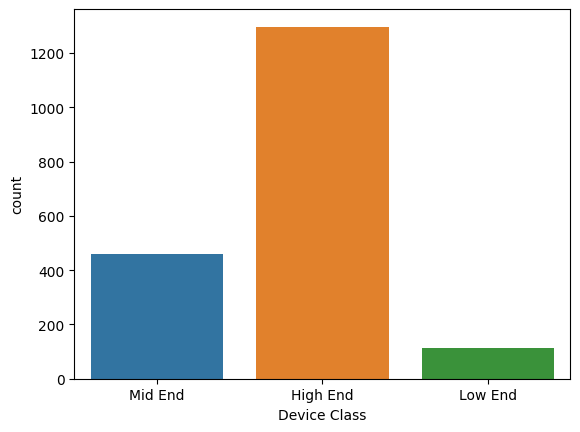

In [ ]:
sns.countplot(data=df, x="Device Class")

<Axes: xlabel='Games Product', ylabel='count'>

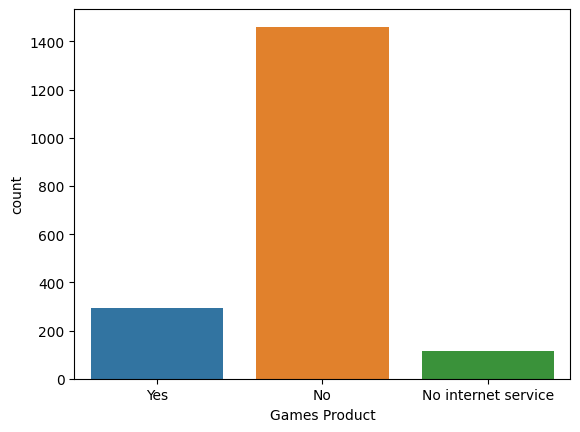

In [ ]:
sns.countplot(data=df, x="Games Product")

<Axes: xlabel='Music Product', ylabel='count'>

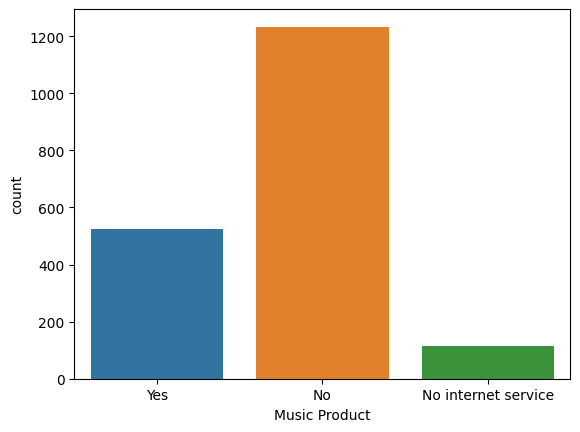

In [ ]:
sns.countplot(data=df, x="Music Product")

<Axes: xlabel='Education Product', ylabel='count'>

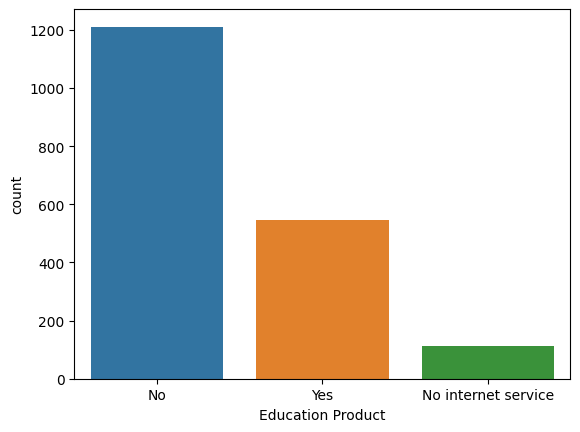

In [ ]:
sns.countplot(data=df, x="Education Product")

<Axes: xlabel='Call Center', ylabel='count'>

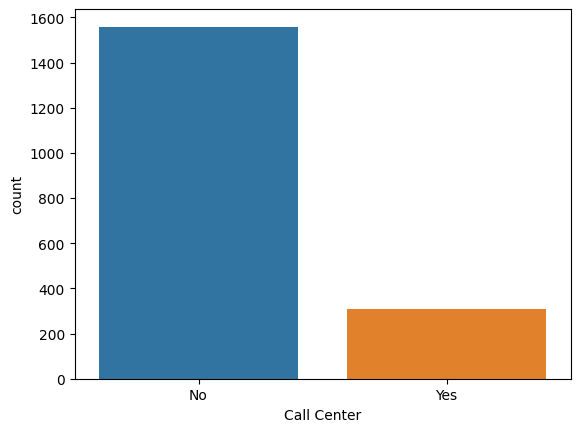

In [ ]:
sns.countplot(data=df, x="Call Center")

<Axes: xlabel='Video Product', ylabel='count'>

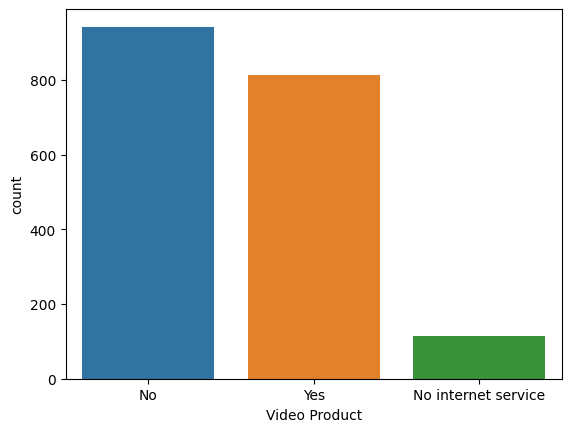

In [ ]:
sns.countplot(data=df, x="Video Product")

<Axes: xlabel='Use MyApp', ylabel='count'>

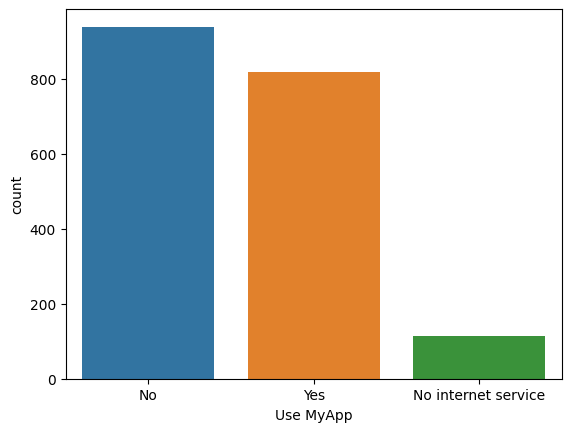

In [ ]:
sns.countplot(data=df, x="Use MyApp")

<Axes: xlabel='Payment Method', ylabel='count'>

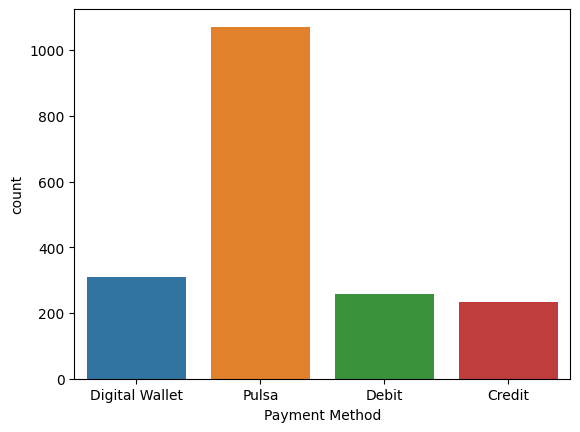

In [ ]:
sns.countplot(data=df, x="Payment Method")

In [ ]:
df3 = df.copy()
df3["Monthly Purchase (Thou. IDR)"] = df3["Monthly Purchase (Thou. IDR)"]//20*20+20

<Axes: xlabel='Monthly Purchase (Thou. IDR)', ylabel='count'>

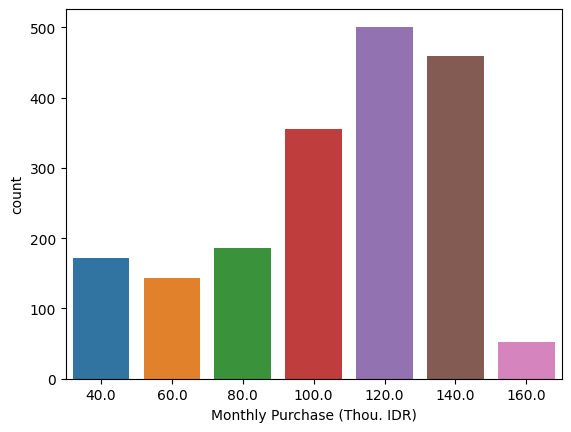

In [ ]:
sns.countplot(data=df3, x="Monthly Purchase (Thou. IDR)")

In [ ]:
df4 = df.copy()
df4["CLTV (Predicted Thou. IDR)"] = df4["CLTV (Predicted Thou. IDR)"]//1000*1000+1000

<Axes: xlabel='CLTV (Predicted Thou. IDR)', ylabel='count'>

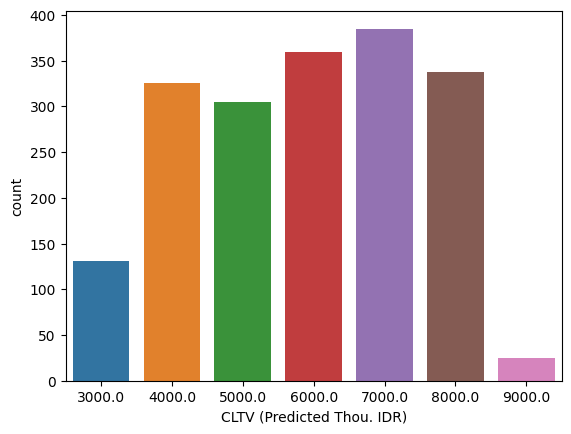

In [ ]:
sns.countplot(data=df4, x="CLTV (Predicted Thou. IDR)")

In [ ]:
df5 = df.copy()
df5['Total Purchase'] = df5['Monthly Purchase (Thou. IDR)'] * df5['Tenure Months']
df5["Total Purchase"] = df5["Total Purchase"]//1000*1000+1000

In [ ]:
df5["Total Purchase"] = df5["Total Purchase"].astype(int)

<Axes: xlabel='Total Purchase', ylabel='count'>

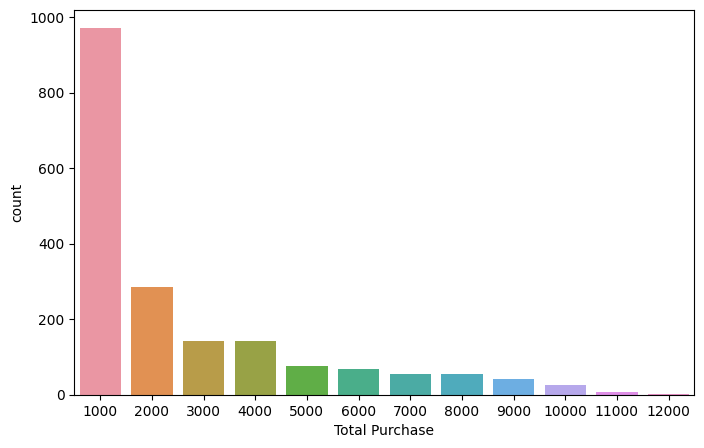

In [ ]:
plt.figure(figsize=(8, 5))
sns.countplot(data=df5, x="Total Purchase")

In [ ]:
df5 = df.copy()
df5['Total Purchase'] = df5['Monthly Purchase (Thou. IDR)'] * df5['Tenure Months']

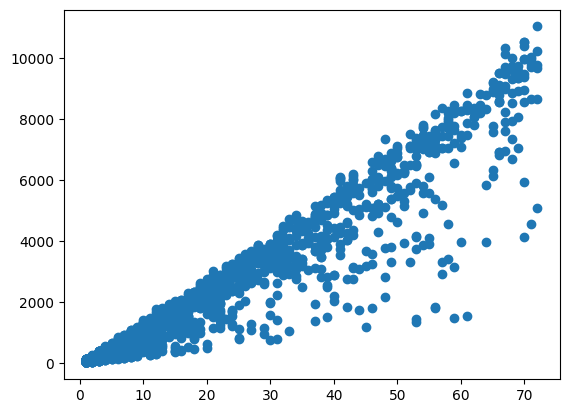

In [ ]:
y = df5['Total Purchase']
x = df5['Tenure Months']
plt.scatter(x, y)
plt.show()

### Clustering

In [ ]:
df = pd.read_excel('Telco_customer_churn_adapted_v2.xlsx')
df = df.drop(columns=['Longitude', 'Latitude', 'Customer ID'])
df = df[df['Churn Label'] == 'Yes']
df['Total Purchase'] = df['Monthly Purchase (Thou. IDR)'] * df['Tenure Months']
df = df[df['Games Product'] != 'No Internet Service']
df[['Games Product','Music Product','Education Product','Call Center','Video Product','Use MyApp','Churn Label']] = (df[['Games Product','Music Product','Education Product','Call Center','Video Product','Use MyApp','Churn Label']] == 'Yes').astype(int)
df['Location'] = (df['Location'] == 'Jakarta').astype(int)
df['Device Class'] = (df['Device Class'] == 'High End').astype(int)
df = pd.get_dummies(df, columns=['Payment Method'])

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


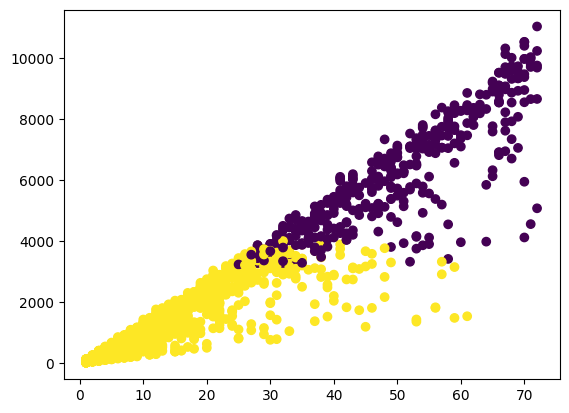

In [ ]:
kmeans = KMeans(n_clusters=2)
kmeans.fit(df)
y = df['Total Purchase']
x = df['Tenure Months']

plt.scatter(x, y, c=kmeans.labels_)
plt.show()

In [ ]:
df2 = df.copy()
cluster_labels = kmeans.fit_predict(df2)
df2['Cluster'] = cluster_labels

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [ ]:
df = pd.read_excel('Telco_customer_churn_adapted_v2.xlsx')
df = df.drop(columns=['Longitude', 'Latitude', 'Customer ID'])
df = pd.concat([df, df2['Cluster']], axis=1)
df = df[df['Churn Label'] == 'Yes']
df = df[df['Cluster'] == 1]

In [ ]:
df2 = df.copy()
df2["Tenure Months"] = df2["Tenure Months"]//10*10+10

<Axes: xlabel='Tenure Months', ylabel='count'>

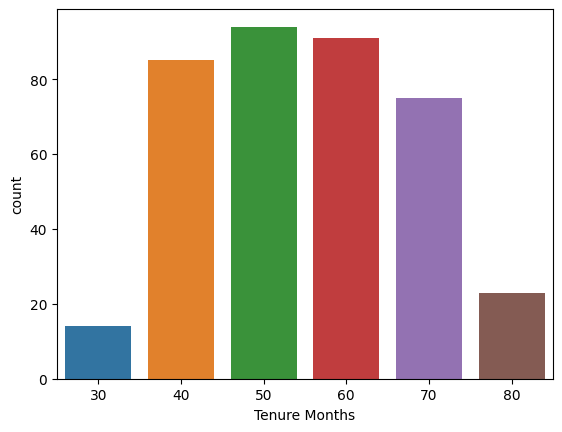

In [ ]:
sns.countplot(data=df2, x="Tenure Months")

<Axes: xlabel='Location', ylabel='count'>

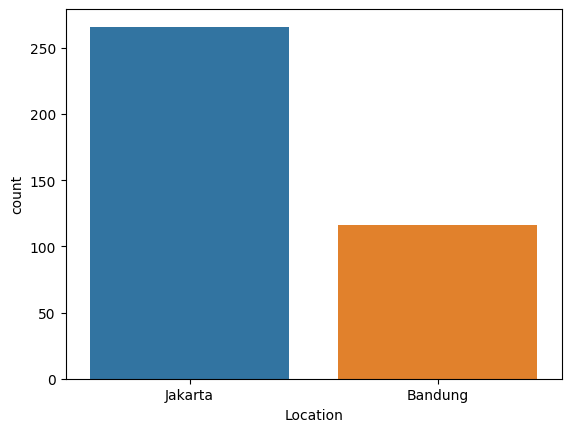

In [ ]:
sns.countplot(data=df, x="Location")

<Axes: xlabel='Device Class', ylabel='count'>

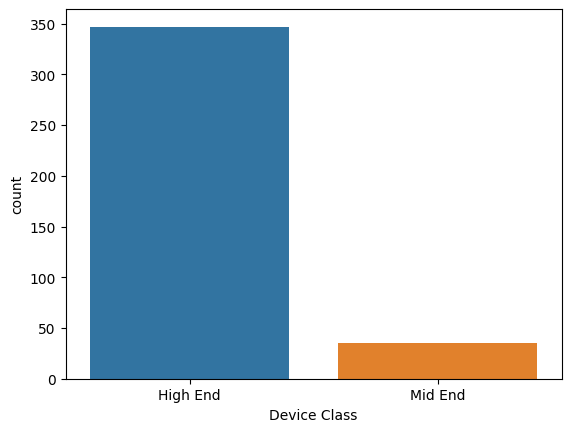

In [ ]:
sns.countplot(data=df, x="Device Class")

<Axes: xlabel='Games Product', ylabel='count'>

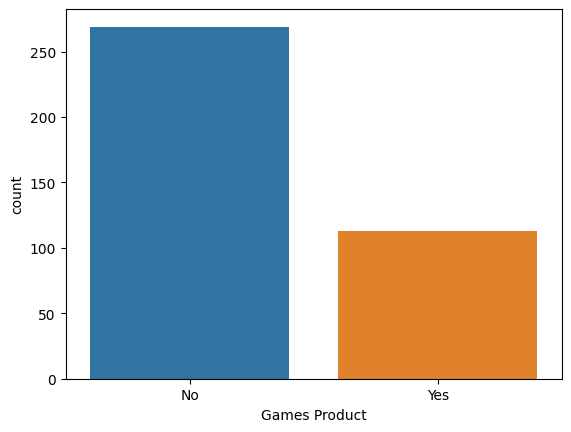

In [ ]:
sns.countplot(data=df, x="Games Product")

<Axes: xlabel='Music Product', ylabel='count'>

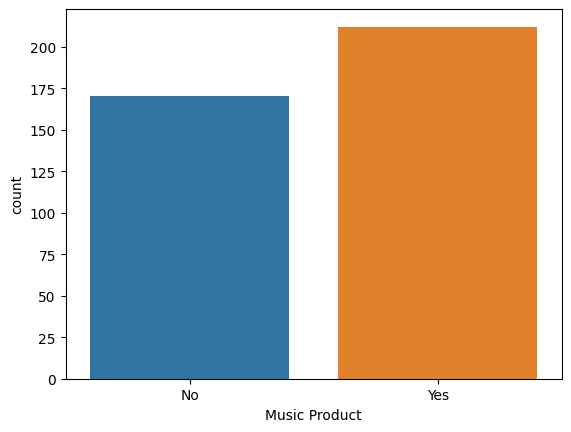

In [ ]:
sns.countplot(data=df, x="Music Product")

<Axes: xlabel='Education Product', ylabel='count'>

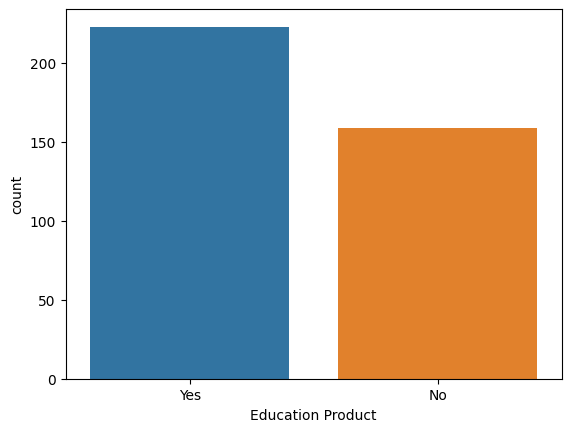

In [ ]:
sns.countplot(data=df, x="Education Product")

<Axes: xlabel='Call Center', ylabel='count'>

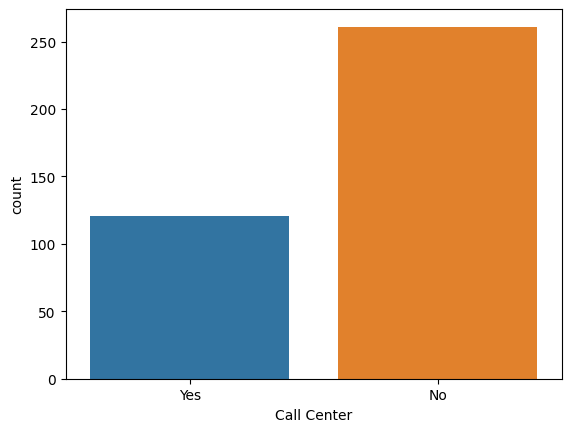

In [ ]:
sns.countplot(data=df, x="Call Center")

<Axes: xlabel='Video Product', ylabel='count'>

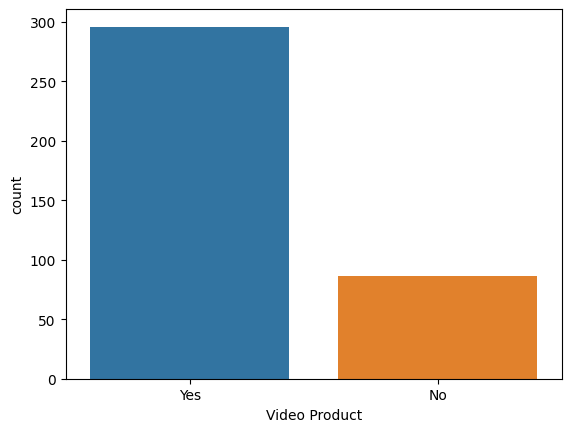

In [ ]:
sns.countplot(data=df, x="Video Product")

<Axes: xlabel='Use MyApp', ylabel='count'>

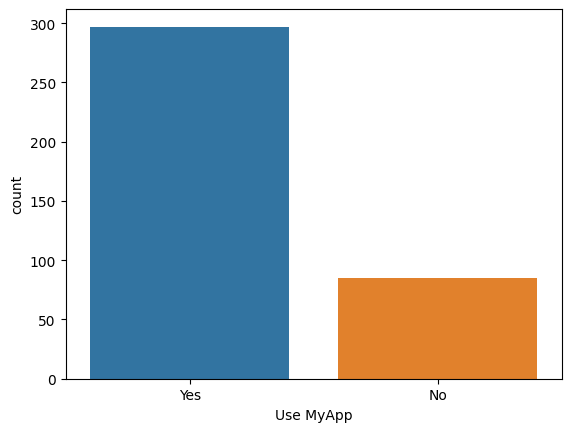

In [ ]:
sns.countplot(data=df, x="Use MyApp")

<Axes: xlabel='Payment Method', ylabel='count'>

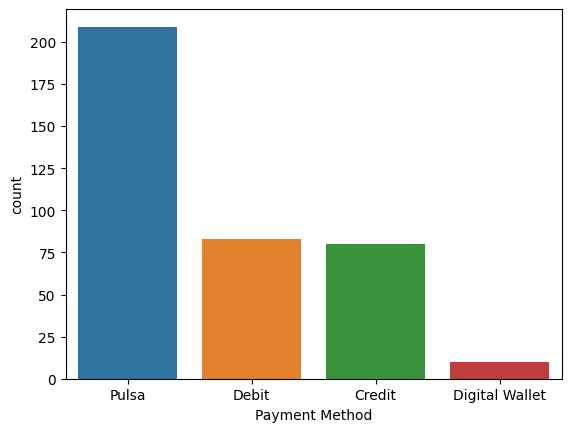

In [ ]:
sns.countplot(data=df, x="Payment Method")

In [ ]:
df3 = df.copy()
df3["Monthly Purchase (Thou. IDR)"] = df3["Monthly Purchase (Thou. IDR)"]//20*20+20

<Axes: xlabel='Monthly Purchase (Thou. IDR)', ylabel='count'>

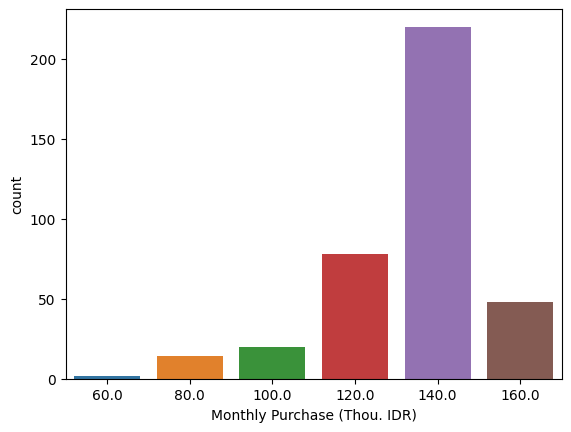

In [ ]:
sns.countplot(data=df3, x="Monthly Purchase (Thou. IDR)")

In [ ]:
df4 = df.copy()
df4["CLTV (Predicted Thou. IDR)"] = df4["CLTV (Predicted Thou. IDR)"]//1000*1000+1000

<Axes: xlabel='CLTV (Predicted Thou. IDR)', ylabel='count'>

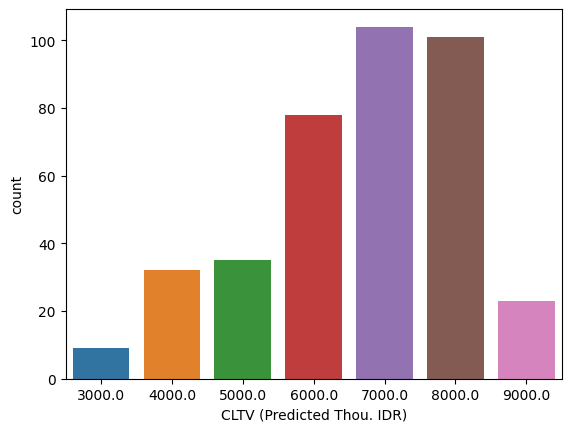

In [ ]:
sns.countplot(data=df4, x="CLTV (Predicted Thou. IDR)")

In [ ]:
df5 = df.copy()
df5['Total Purchase'] = df5['Monthly Purchase (Thou. IDR)'] * df5['Tenure Months']
df5["Total Purchase"] = df5["Total Purchase"]//1000*1000+1000

In [ ]:
df5["Total Purchase"] = df5["Total Purchase"].astype(int)

<Axes: xlabel='Total Purchase', ylabel='count'>

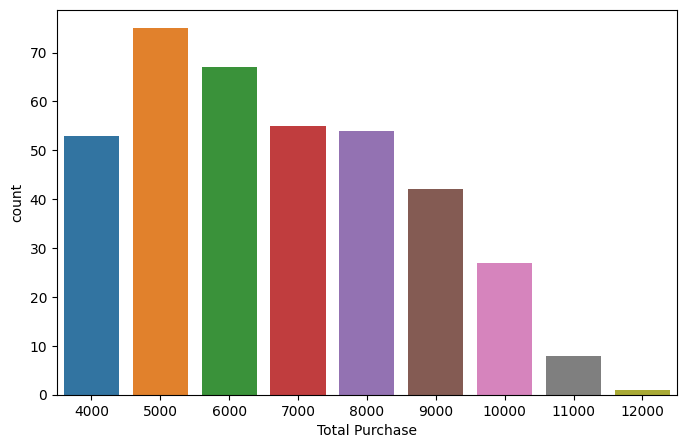

In [ ]:
plt.figure(figsize=(8, 5))
sns.countplot(data=df5, x="Total Purchase")

## Non-Churn Customers

In [ ]:
df = pd.read_excel('Telco_customer_churn_adapted_v2.xlsx')
df = df.drop(columns=['Longitude', 'Latitude', 'Customer ID'])
df = df[df['Churn Label'] == 'No']

In [ ]:
df2 = df.copy()
df2["Tenure Months"] = df2["Tenure Months"]//10*10+10

<Axes: xlabel='Tenure Months', ylabel='count'>

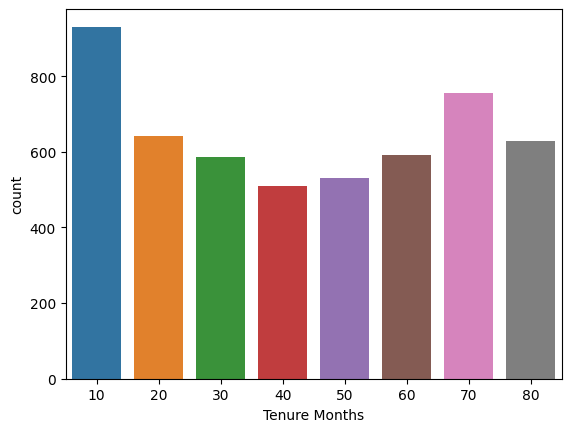

In [ ]:
sns.countplot(data=df2, x="Tenure Months")

<Axes: xlabel='Location', ylabel='count'>

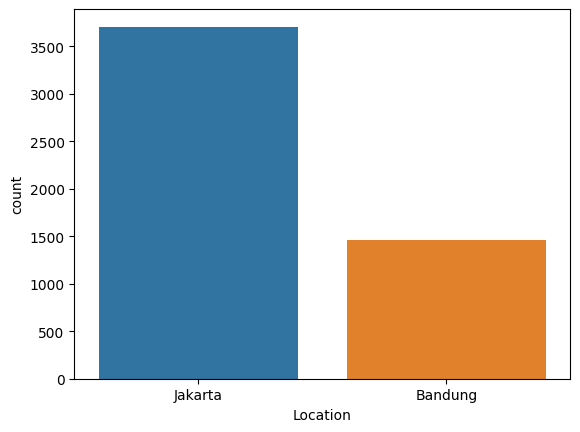

In [ ]:
sns.countplot(data=df, x="Location")

<Axes: xlabel='Device Class', ylabel='count'>

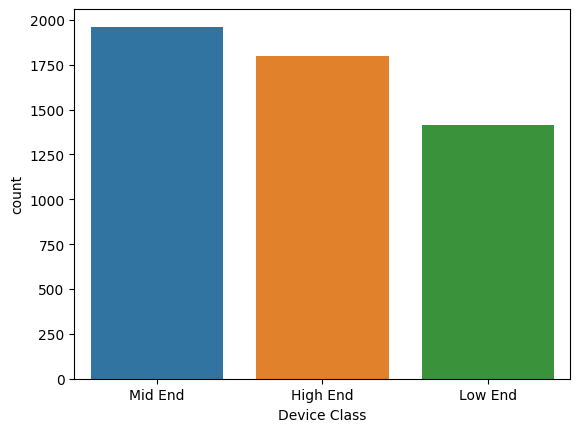

In [ ]:
sns.countplot(data=df, x="Device Class")

<Axes: xlabel='Games Product', ylabel='count'>

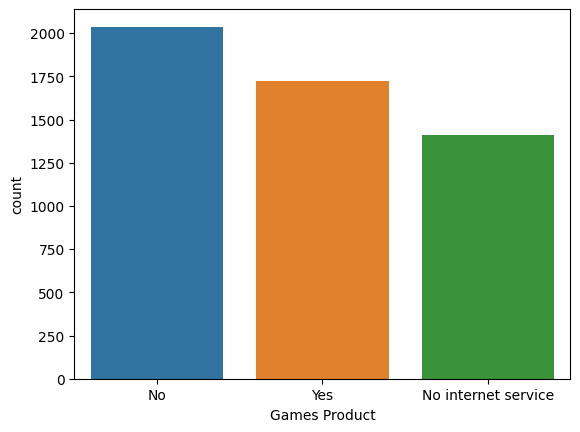

In [ ]:
sns.countplot(data=df, x="Games Product")

<Axes: xlabel='Music Product', ylabel='count'>

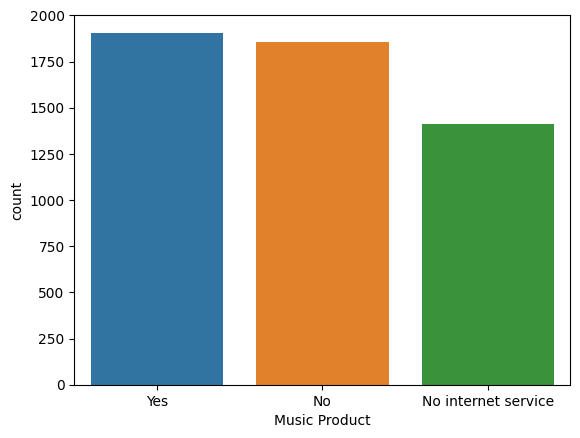

In [ ]:
sns.countplot(data=df, x="Music Product")

<Axes: xlabel='Education Product', ylabel='count'>

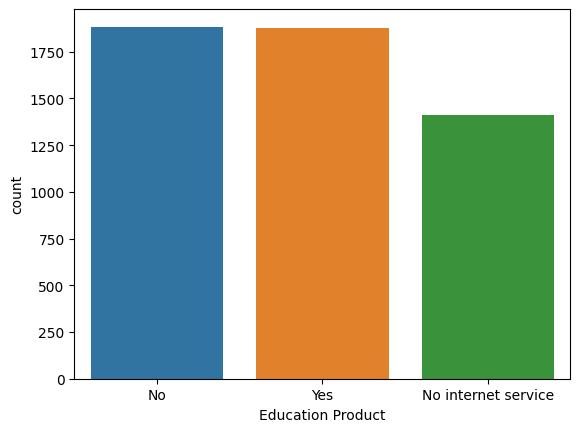

In [ ]:
sns.countplot(data=df, x="Education Product")

<Axes: xlabel='Call Center', ylabel='count'>

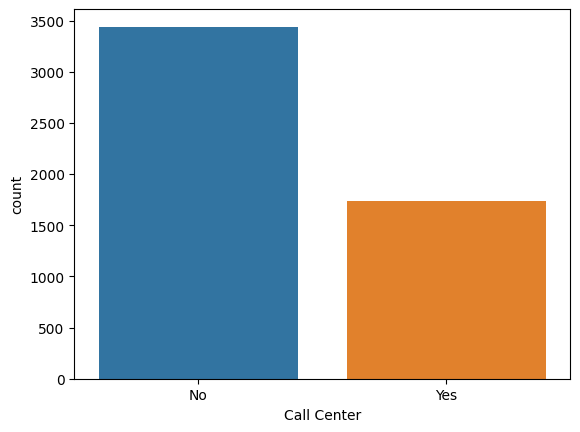

In [ ]:
sns.countplot(data=df, x="Call Center")

<Axes: xlabel='Video Product', ylabel='count'>

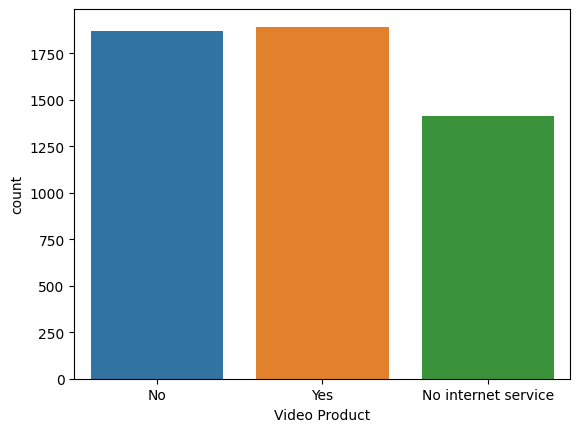

In [ ]:
sns.countplot(data=df, x="Video Product")

<Axes: xlabel='Use MyApp', ylabel='count'>

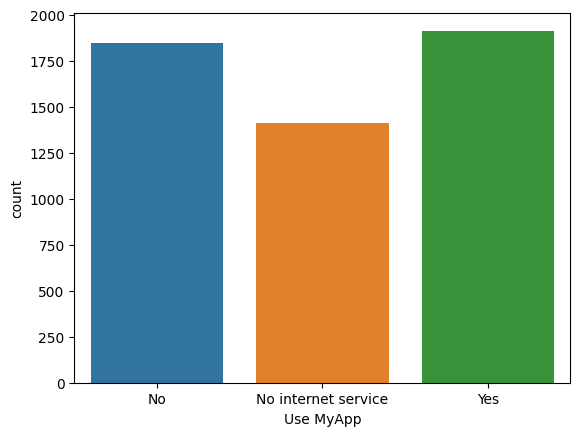

In [ ]:
sns.countplot(data=df, x="Use MyApp")

<Axes: xlabel='Payment Method', ylabel='count'>

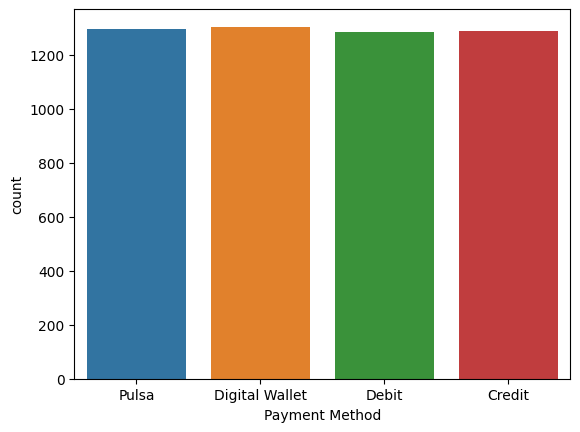

In [ ]:
sns.countplot(data=df, x="Payment Method")

In [ ]:
df3 = df.copy()
df3["Monthly Purchase (Thou. IDR)"] = df3["Monthly Purchase (Thou. IDR)"]//20*20+20

<Axes: xlabel='Monthly Purchase (Thou. IDR)', ylabel='count'>

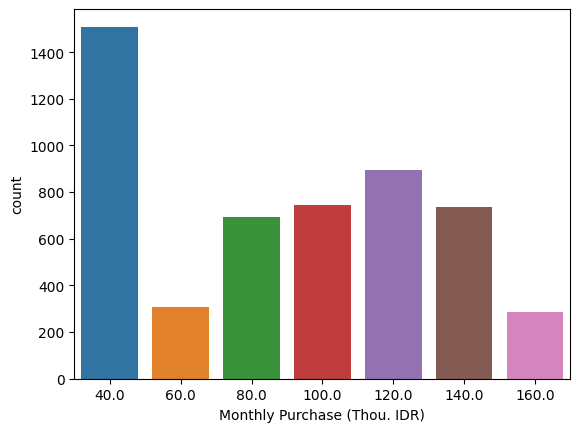

In [ ]:
sns.countplot(data=df3, x="Monthly Purchase (Thou. IDR)")

In [ ]:
df4 = df.copy()
df4["CLTV (Predicted Thou. IDR)"] = df4["CLTV (Predicted Thou. IDR)"]//1000*1000+1000

<Axes: xlabel='CLTV (Predicted Thou. IDR)', ylabel='count'>

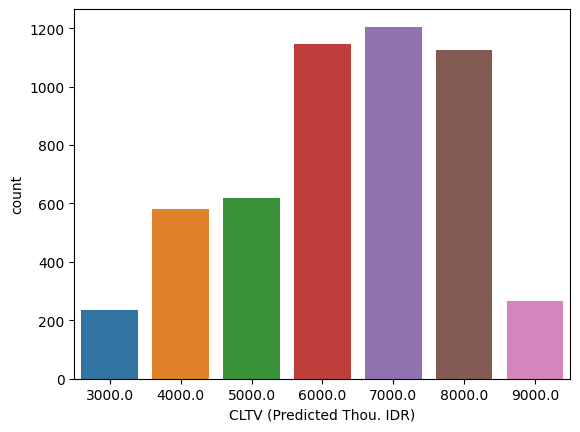

In [ ]:
sns.countplot(data=df4, x="CLTV (Predicted Thou. IDR)")

In [ ]:
df['Total Purchase'] = df['Monthly Purchase (Thou. IDR)'] * df['Tenure Months']
df = df.sort_values(by='Total Purchase', ascending= False)
df

,Tenure Months,Location,Device Class,Games Product,Music Product,Education Product,Call Center,Video Product,Use MyApp,Payment Method,Monthly Purchase (Thou. IDR),Churn Label,CLTV (Predicted Thou. IDR),Total Purchase
5251,72,Jakarta,High End,Yes,Yes,Yes,Yes,Yes,Yes,Debit,154.375,No,7117.5,11115.00
6372,72,Jakarta,High End,Yes,Yes,Yes,Yes,Yes,Yes,Pulsa,153.660,No,6351.8,11063.52
4235,72,Bandung,High End,Yes,Yes,Yes,Yes,Yes,Yes,Debit,152.880,No,8024.9,11007.36
6850,72,Jakarta,High End,Yes,Yes,Yes,Yes,Yes,Yes,Credit,152.750,No,7811.7,10998.00
4931,72,Jakarta,High End,Yes,Yes,Yes,Yes,Yes,Yes,Credit,152.555,No,5210.4,10983.96
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5719,0,Bandung,Low End,No internet service,No internet service,No internet service,No,No internet service,No internet service,Digital Wallet,25.610,No,6357.0,0.00
2667,0,Jakarta,Low End,No internet service,No internet service,No internet service,No,No internet service,No internet service,Digital Wallet,33.475,No,6435.0,0.00
2438,0,Jakarta,Low End,No internet service,No internet service,No internet service,No,No internet service,No internet service,Digital Wallet,26.325,No,7155.2,0.00
2856,0,Jakarta,Mid End,Yes,Yes,Yes,Yes,Yes,No,Credit,72.865,No,6162.0,0.00


In [ ]:
df4 = df.copy()
df4["Total Purchase"] = df4["Total Purchase"]//1000*1000+1000

In [ ]:
df4["Total Purchase"] = df4["Total Purchase"].astype(int)

<Axes: xlabel='Total Purchase', ylabel='count'>

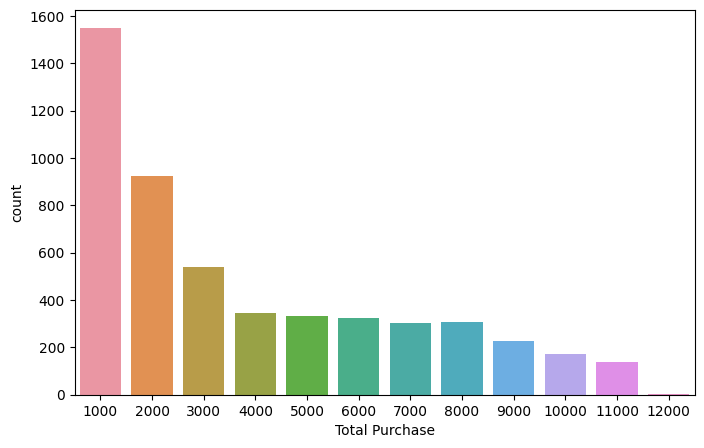

In [ ]:
plt.figure(figsize=(8, 5))
sns.countplot(data=df4, x="Total Purchase")

# Clustering (n = 2)

In [ ]:
df

,Tenure Months,Location,Device Class,Games Product,Music Product,Education Product,Call Center,Video Product,Use MyApp,Payment Method,Monthly Purchase (Thou. IDR),Churn Label,CLTV (Predicted Thou. IDR),Total Purchase
5251,72,Jakarta,High End,Yes,Yes,Yes,Yes,Yes,Yes,Debit,154.375,No,7117.5,11115.00
6372,72,Jakarta,High End,Yes,Yes,Yes,Yes,Yes,Yes,Pulsa,153.660,No,6351.8,11063.52
4235,72,Bandung,High End,Yes,Yes,Yes,Yes,Yes,Yes,Debit,152.880,No,8024.9,11007.36
6850,72,Jakarta,High End,Yes,Yes,Yes,Yes,Yes,Yes,Credit,152.750,No,7811.7,10998.00
4931,72,Jakarta,High End,Yes,Yes,Yes,Yes,Yes,Yes,Credit,152.555,No,5210.4,10983.96
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5719,0,Bandung,Low End,No internet service,No internet service,No internet service,No,No internet service,No internet service,Digital Wallet,25.610,No,6357.0,0.00
2667,0,Jakarta,Low End,No internet service,No internet service,No internet service,No,No internet service,No internet service,Digital Wallet,33.475,No,6435.0,0.00
2438,0,Jakarta,Low End,No internet service,No internet service,No internet service,No,No internet service,No internet service,Digital Wallet,26.325,No,7155.2,0.00
2856,0,Jakarta,Mid End,Yes,Yes,Yes,Yes,Yes,No,Credit,72.865,No,6162.0,0.00


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

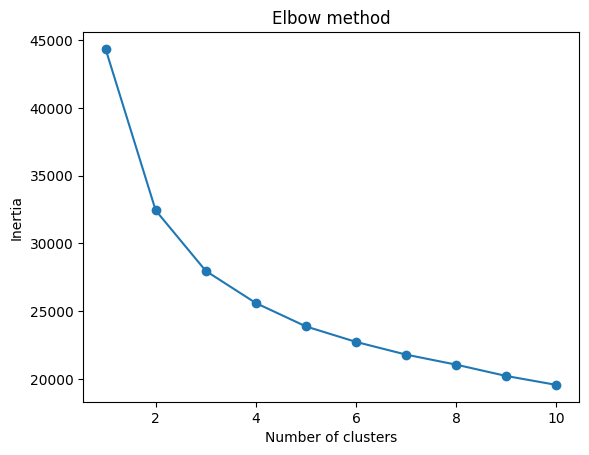

In [ ]:
df = pd.read_excel('Telco_customer_churn_adapted_v2.xlsx')
df5 = df.copy()
df5 = df5.drop(columns=['Customer ID'])
scaler = MinMaxScaler()
columns_to_normalize = ["Tenure Months","Monthly Purchase (Thou. IDR)","CLTV (Predicted Thou. IDR)"]
df5[columns_to_normalize] = scaler.fit_transform(df5[columns_to_normalize])
inertias = []
object_columns = df5.select_dtypes(include=['object'])
object_columns = object_columns.columns.tolist()
df5 = pd.get_dummies(df5, columns=object_columns)

for i in range(1,11):
    kmeans = KMeans(n_clusters=i)
    kmeans.fit(df5)
    inertias.append(kmeans.inertia_)

plt.plot(range(1,11), inertias, marker='o')
plt.title('Elbow method')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


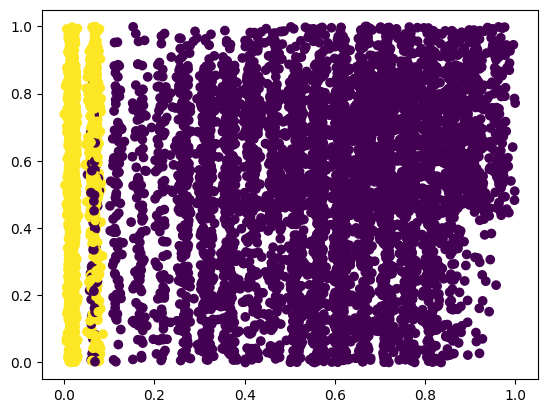

In [ ]:
kmeans = KMeans(n_clusters=2)
kmeans.fit(df5)
y = df5['CLTV (Predicted Thou. IDR)']
x = df5['Monthly Purchase (Thou. IDR)']

plt.scatter(x, y, c=kmeans.labels_)
plt.show()

In [ ]:
cluster_labels = kmeans.fit_predict(df5)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [ ]:
df5['Cluster'] = cluster_labels

In [ ]:
silhouette_avg = silhouette_score(df5, cluster_labels)
print("Silhouette Score:", silhouette_avg)

Silhouette Score: 0.31563190263044355


In [ ]:
df5[df5['Cluster'] == 0]

,Tenure Months,Monthly Purchase (Thou. IDR),Longitude,Latitude,CLTV (Predicted Thou. IDR),Location_Bandung,Location_Jakarta,Device Class_High End,Device Class_Low End,Device Class_Mid End,...,Use MyApp_No,Use MyApp_No internet service,Use MyApp_Yes,Payment Method_Credit,Payment Method_Debit,Payment Method_Digital Wallet,Payment Method_Pulsa,Churn Label_No,Churn Label_Yes,Cluster
7,0.013889,0.018905,106.816666,-6.200000,0.629086,0,1,0,1,0,...,0,1,0,0,0,1,0,0,1,0
22,0.069444,0.027861,106.816666,-6.200000,0.133645,0,1,0,1,0,...,0,1,0,0,0,1,0,0,1,0
65,0.819444,0.010945,107.609810,-6.914744,0.685123,1,0,0,1,0,...,0,1,0,0,0,1,0,0,1,0
99,0.152778,0.016915,106.816666,-6.200000,0.863909,0,1,0,1,0,...,0,1,0,0,0,1,0,0,1,0
103,0.013889,0.016418,106.816666,-6.200000,0.299755,0,1,0,1,0,...,0,1,0,0,0,1,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7023,0.708333,0.023881,106.816666,-6.200000,0.605292,0,1,0,1,0,...,0,1,0,0,1,0,0,1,0,0
7024,0.541667,0.018905,106.816666,-6.200000,0.000889,0,1,0,1,0,...,0,1,0,0,0,1,0,1,0,0
7025,0.166667,0.009453,106.816666,-6.200000,0.244163,0,1,0,1,0,...,0,1,0,0,0,0,1,1,0,0
7033,0.027778,0.017910,106.816666,-6.200000,0.708917,0,1,0,1,0,...,0,1,0,0,0,1,0,1,0,0


In [ ]:
df5[df5['Cluster'] == 1]

,Tenure Months,Monthly Purchase (Thou. IDR),Longitude,Latitude,CLTV (Predicted Thou. IDR),Location_Bandung,Location_Jakarta,Device Class_High End,Device Class_Low End,Device Class_Mid End,...,Use MyApp_No,Use MyApp_No internet service,Use MyApp_Yes,Payment Method_Credit,Payment Method_Debit,Payment Method_Digital Wallet,Payment Method_Pulsa,Churn Label_No,Churn Label_Yes,Cluster
0,0.027778,0.354229,106.816666,-6.2,0.274850,0,1,0,0,1,...,1,0,0,0,0,1,0,0,1,1
1,0.027778,0.521891,106.816666,-6.2,0.155215,0,1,1,0,0,...,1,0,0,0,0,0,1,0,1,1
2,0.111111,0.809950,106.816666,-6.2,0.749166,0,1,1,0,0,...,0,0,1,0,0,0,1,0,1,1
3,0.388889,0.861194,106.816666,-6.2,0.667111,0,1,1,0,0,...,0,0,1,0,0,0,1,0,1,1
4,0.680556,0.850249,106.816666,-6.2,0.742050,0,1,1,0,0,...,0,0,1,0,1,0,0,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7037,0.166667,0.421891,106.816666,-6.2,0.386258,0,1,0,0,1,...,0,0,1,0,0,0,1,1,0,1
7039,0.333333,0.662189,106.816666,-6.2,0.030465,0,1,0,0,1,...,0,0,1,0,0,1,0,1,0,1
7040,1.000000,0.845274,106.816666,-6.2,0.790972,0,1,1,0,0,...,0,0,1,1,0,0,0,1,0,1
7041,0.152778,0.112935,106.816666,-6.2,0.175673,0,1,0,0,1,...,1,0,0,0,0,0,1,1,0,1


In [ ]:
df = pd.concat([df, df5['Cluster']], axis=1)

# Data Visualization (Cluster 0)

In [ ]:
df2 = df[df['Cluster'] == 0].copy()
df2["Tenure Months"] = df2["Tenure Months"]//10*10+10

<Axes: xlabel='Tenure Months', ylabel='count'>

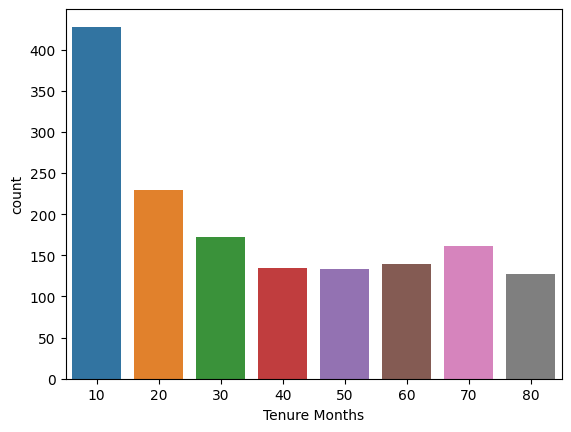

In [ ]:
sns.countplot(data=df2, x="Tenure Months")

<Axes: xlabel='Location', ylabel='count'>

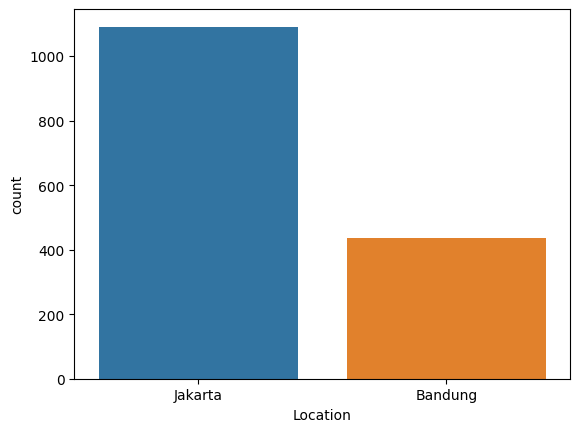

In [ ]:
sns.countplot(data=df[df['Cluster'] == 0], x="Location")

<Axes: xlabel='Device Class', ylabel='count'>

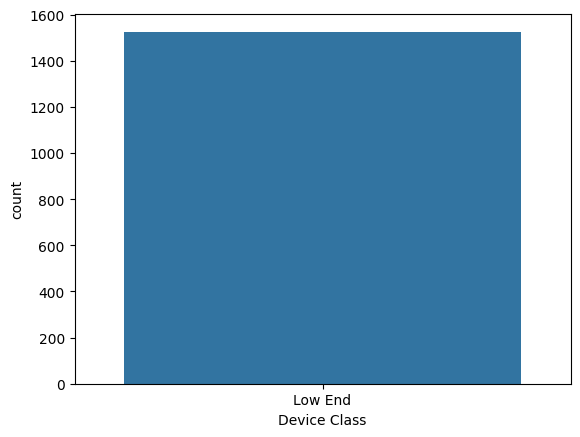

In [ ]:
sns.countplot(data=df[df['Cluster'] == 0], x="Device Class")

<Axes: xlabel='Games Product', ylabel='count'>

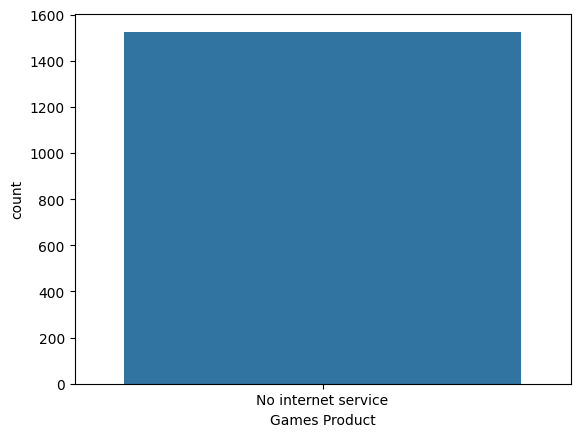

In [ ]:
sns.countplot(data=df[df['Cluster'] == 0], x="Games Product")

<Axes: xlabel='Music Product', ylabel='count'>

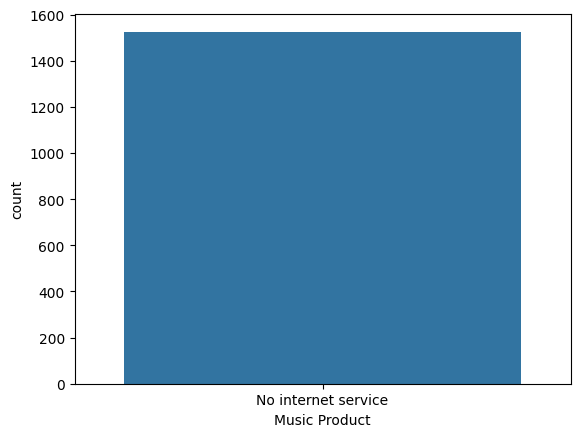

In [ ]:
sns.countplot(data=df[df['Cluster'] == 0], x="Music Product")

<Axes: xlabel='Education Product', ylabel='count'>

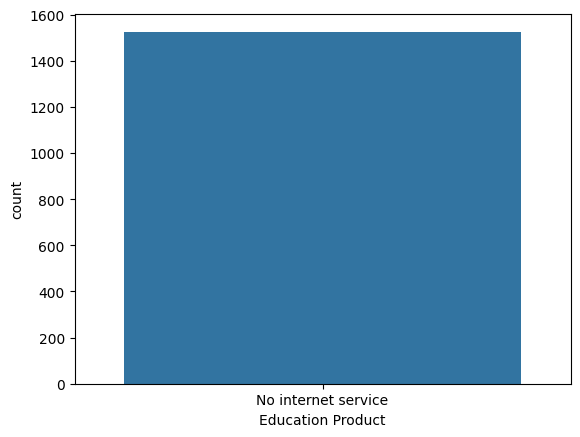

In [ ]:
sns.countplot(data=df[df['Cluster'] == 0], x="Education Product")

<Axes: xlabel='Call Center', ylabel='count'>

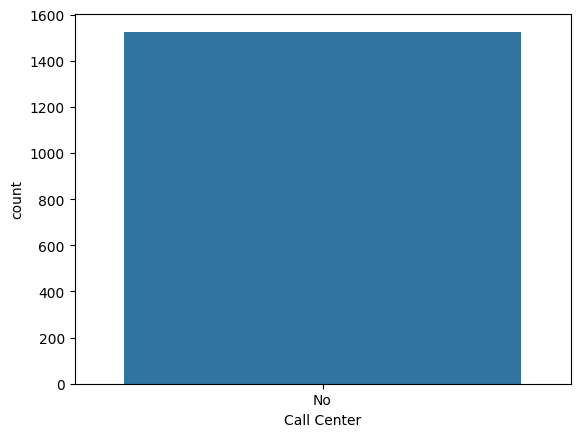

In [ ]:
sns.countplot(data=df[df['Cluster'] == 0], x="Call Center")

<Axes: xlabel='Video Product', ylabel='count'>

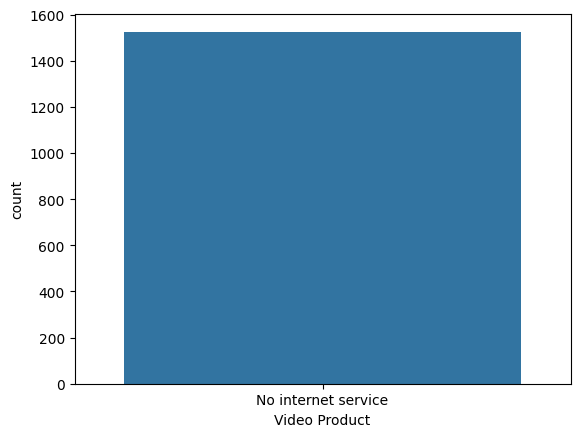

In [ ]:
sns.countplot(data=df[df['Cluster'] == 0], x="Video Product")

<Axes: xlabel='Use MyApp', ylabel='count'>

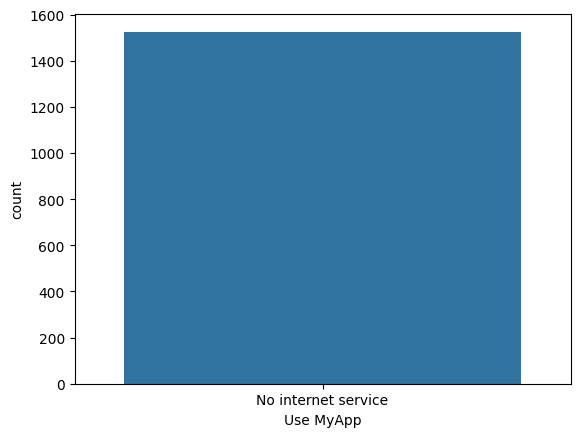

In [ ]:
sns.countplot(data=df[df['Cluster'] == 0], x="Use MyApp")

<Axes: xlabel='Payment Method', ylabel='count'>

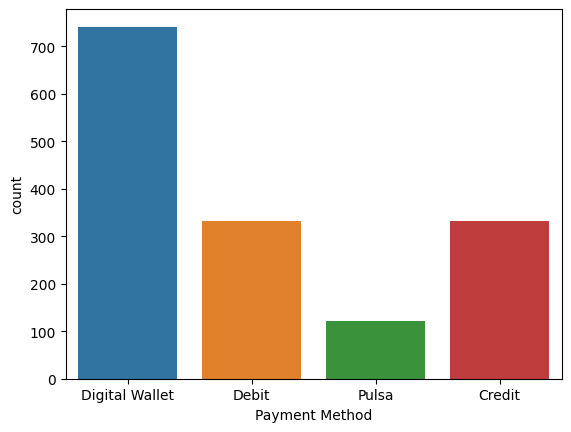

In [ ]:
sns.countplot(data=df[df['Cluster'] == 0], x="Payment Method")

In [ ]:
df3 = df[df['Cluster'] == 0].copy()
df3["Monthly Purchase (Thou. IDR)"] = df3["Monthly Purchase (Thou. IDR)"]//20*20+20

<Axes: xlabel='Monthly Purchase (Thou. IDR)', ylabel='count'>

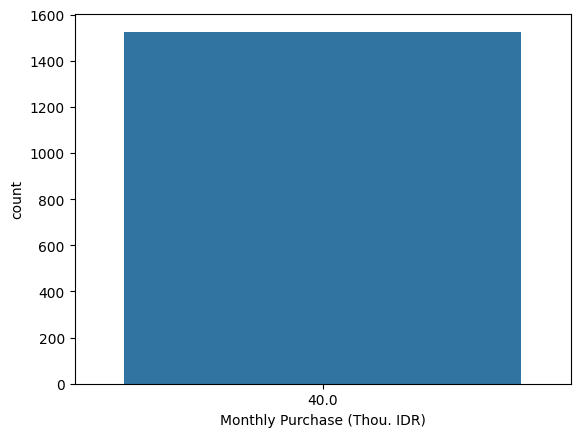

In [ ]:
sns.countplot(data=df3, x="Monthly Purchase (Thou. IDR)")

<Axes: xlabel='Churn Label', ylabel='count'>

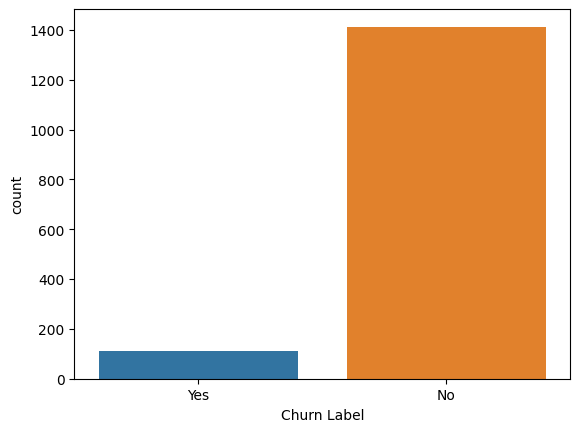

In [ ]:
sns.countplot(data=df[df['Cluster'] == 0], x="Churn Label")

In [ ]:
df4 = df[df['Cluster'] == 0].copy()
df4["CLTV (Predicted Thou. IDR)"] = df4["CLTV (Predicted Thou. IDR)"]//1000*1000+1000

<Axes: xlabel='CLTV (Predicted Thou. IDR)', ylabel='count'>

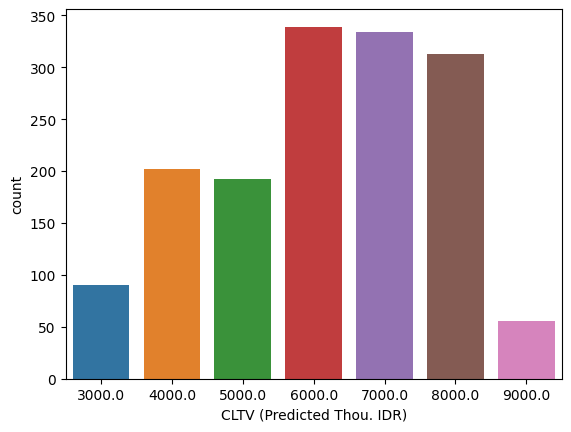

In [ ]:
sns.countplot(data=df4, x="CLTV (Predicted Thou. IDR)")

# Data Visualization (Cluster 1)

In [ ]:
df2 = df[df['Cluster'] == 1].copy()
df2["Tenure Months"] = df2["Tenure Months"]//10*10+10

<Axes: xlabel='Tenure Months', ylabel='count'>

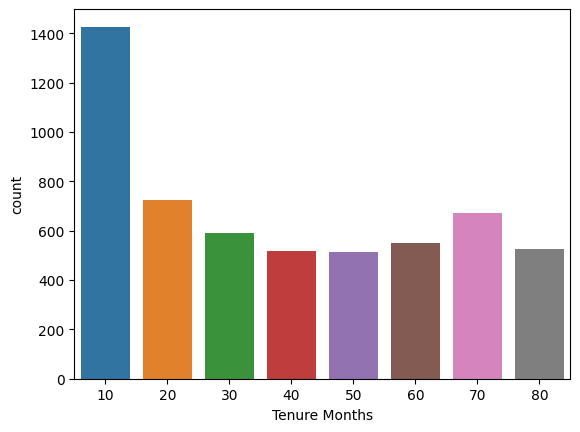

In [ ]:
sns.countplot(data=df2, x="Tenure Months")

<Axes: xlabel='Location', ylabel='count'>

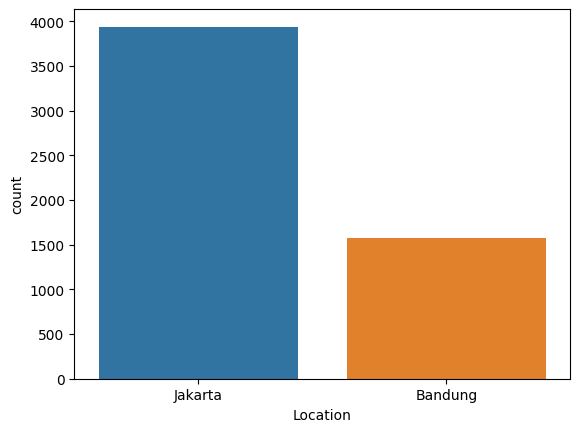

In [ ]:
sns.countplot(data=df[df['Cluster'] == 1], x="Location")

<Axes: xlabel='Device Class', ylabel='count'>

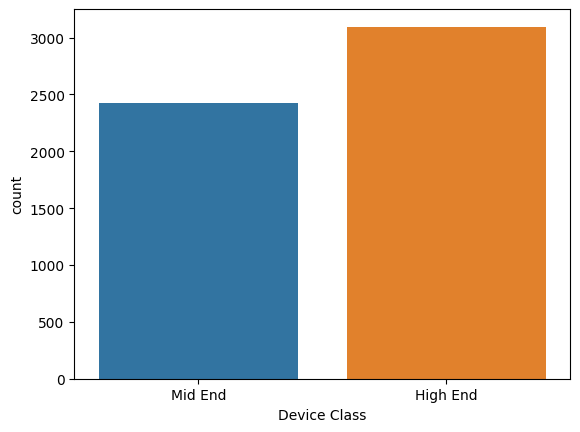

In [ ]:
sns.countplot(data=df[df['Cluster'] == 1], x="Device Class")

<Axes: xlabel='Games Product', ylabel='count'>

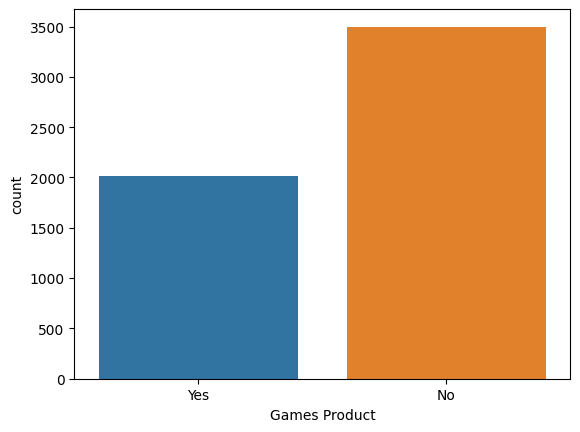

In [ ]:
sns.countplot(data=df[df['Cluster'] == 1], x="Games Product")

<Axes: xlabel='Music Product', ylabel='count'>

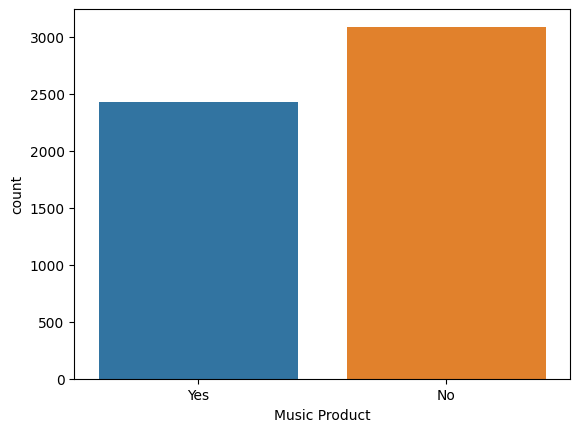

In [ ]:
sns.countplot(data=df[df['Cluster'] == 1], x="Music Product")

<Axes: xlabel='Education Product', ylabel='count'>

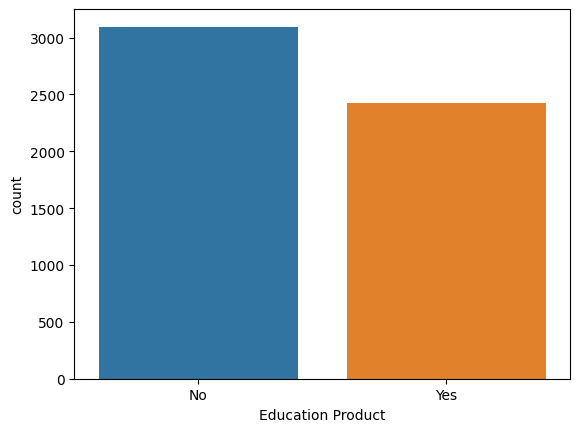

In [ ]:
sns.countplot(data=df[df['Cluster'] == 1], x="Education Product")

<Axes: xlabel='Call Center', ylabel='count'>

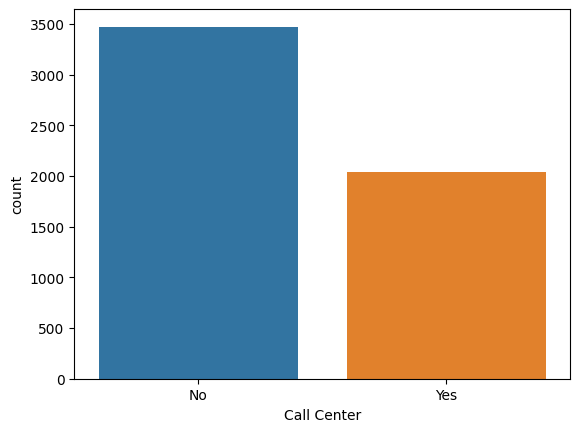

In [ ]:
sns.countplot(data=df[df['Cluster'] == 1], x="Call Center")

<Axes: xlabel='Video Product', ylabel='count'>

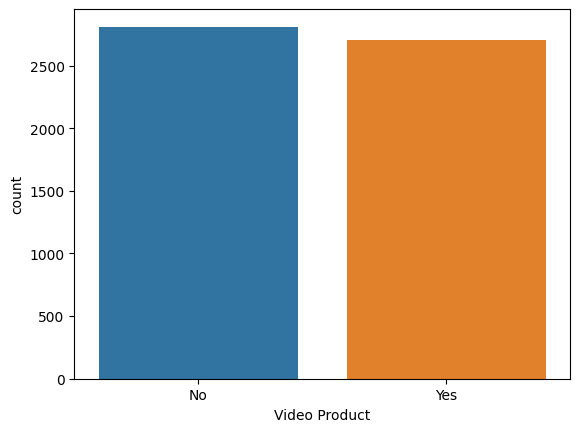

In [ ]:
sns.countplot(data=df[df['Cluster'] == 1], x="Video Product")

<Axes: xlabel='Use MyApp', ylabel='count'>

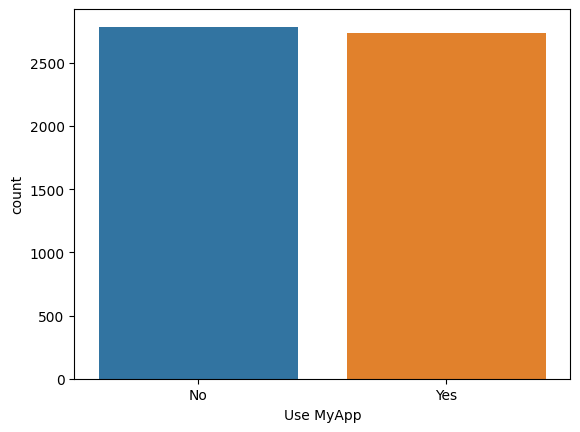

In [ ]:
sns.countplot(data=df[df['Cluster'] == 1], x="Use MyApp")

<Axes: xlabel='Payment Method', ylabel='count'>

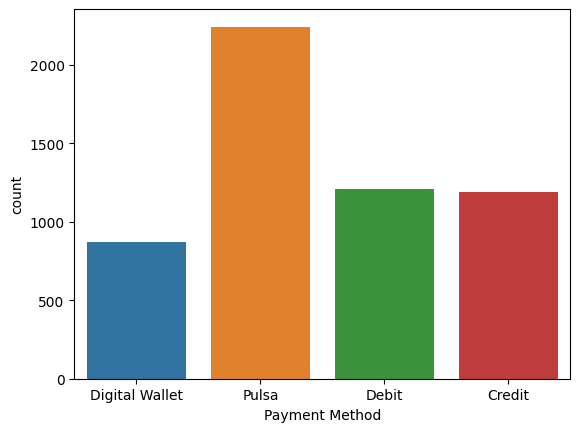

In [ ]:
sns.countplot(data=df[df['Cluster'] == 1], x="Payment Method")

In [ ]:
df3 = df[df['Cluster'] == 1].copy()
df3["Monthly Purchase (Thou. IDR)"] = df3["Monthly Purchase (Thou. IDR)"]//20*20+20

<Axes: xlabel='Monthly Purchase (Thou. IDR)', ylabel='count'>

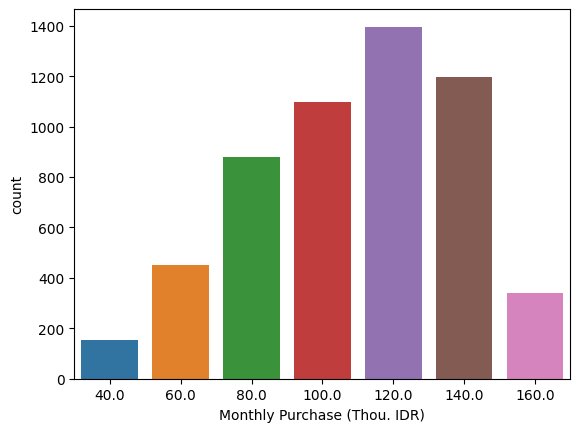

In [ ]:
sns.countplot(data=df3, x="Monthly Purchase (Thou. IDR)")

<Axes: xlabel='Churn Label', ylabel='count'>

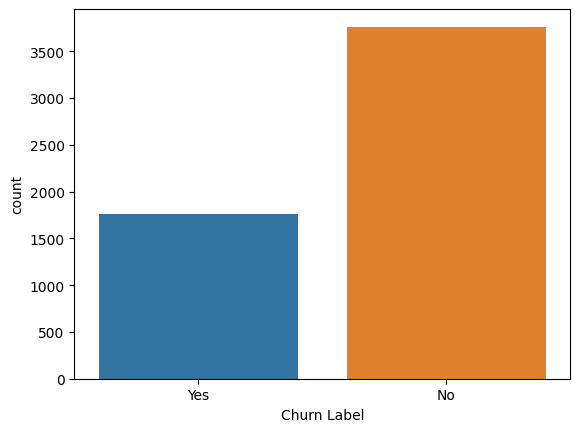

In [ ]:
sns.countplot(data=df[df['Cluster'] == 1], x="Churn Label")

In [ ]:
df4 = df[df['Cluster'] == 1].copy()
df4["CLTV (Predicted Thou. IDR)"] = df4["CLTV (Predicted Thou. IDR)"]//1000*1000+1000

<Axes: xlabel='CLTV (Predicted Thou. IDR)', ylabel='count'>

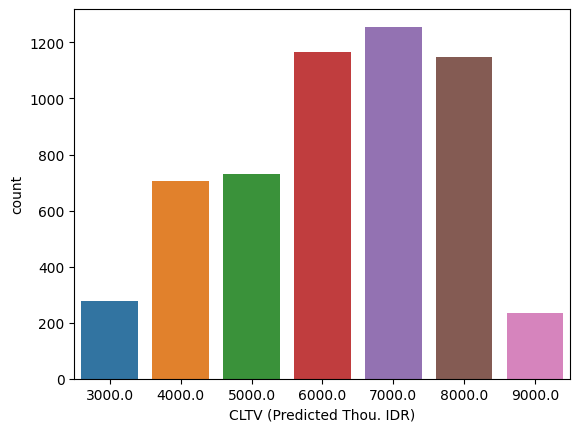

In [ ]:
sns.countplot(data=df4, x="CLTV (Predicted Thou. IDR)")

# Clustering (n = 3)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


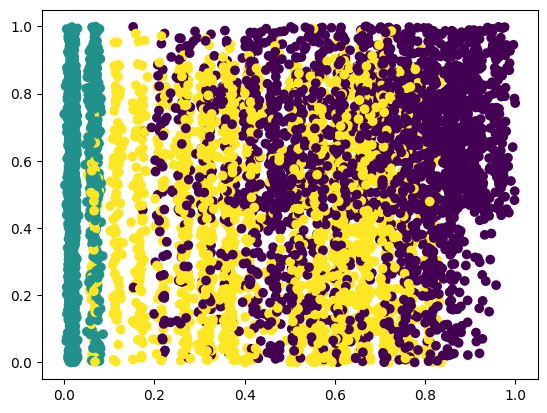

In [ ]:
df5 = df.drop(columns=['Cluster']).copy()
df5 = df5.drop(columns=['Customer ID'])
scaler = MinMaxScaler()
columns_to_normalize = ["Tenure Months","Monthly Purchase (Thou. IDR)","CLTV (Predicted Thou. IDR)"]
df5[columns_to_normalize] = scaler.fit_transform(df5[columns_to_normalize])
inertias = []
object_columns = df5.select_dtypes(include=['object'])
object_columns = object_columns.columns.tolist()
df5 = pd.get_dummies(df5, columns=object_columns)
kmeans = KMeans(n_clusters=3)
kmeans.fit(df5)
y = df5['CLTV (Predicted Thou. IDR)']
x = df5['Monthly Purchase (Thou. IDR)']
plt.scatter(x, y, c=kmeans.labels_)
plt.show()

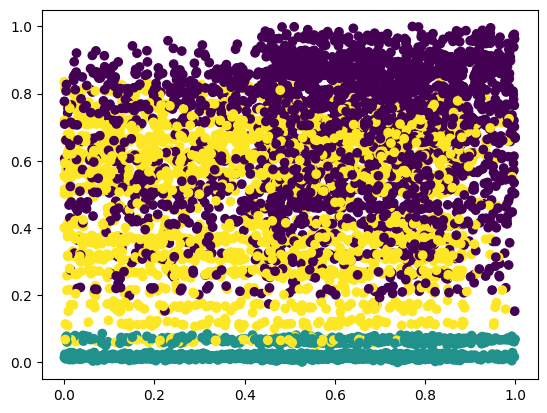

In [ ]:
x = df5['CLTV (Predicted Thou. IDR)']
y = df5['Monthly Purchase (Thou. IDR)']
plt.scatter(x, y, c=kmeans.labels_)
plt.show()

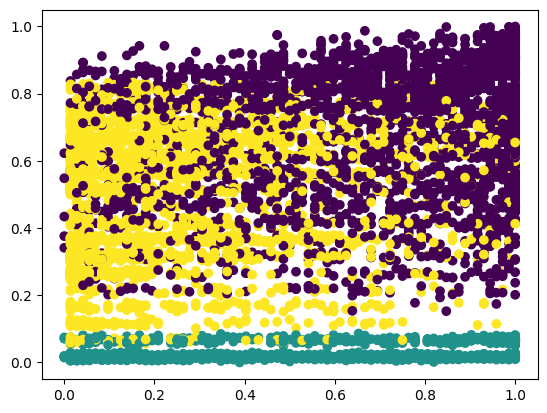

In [ ]:
x = df5['Tenure Months']
y = df5['Monthly Purchase (Thou. IDR)']
plt.scatter(x, y, c=kmeans.labels_)
plt.show()

In [ ]:
cluster_labels = kmeans.fit_predict(df5)
silhouette_avg = silhouette_score(df5, cluster_labels)
print("Silhouette Score:", silhouette_avg)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Silhouette Score: 0.24101903394025467


#Drop No Internet then Cluster

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

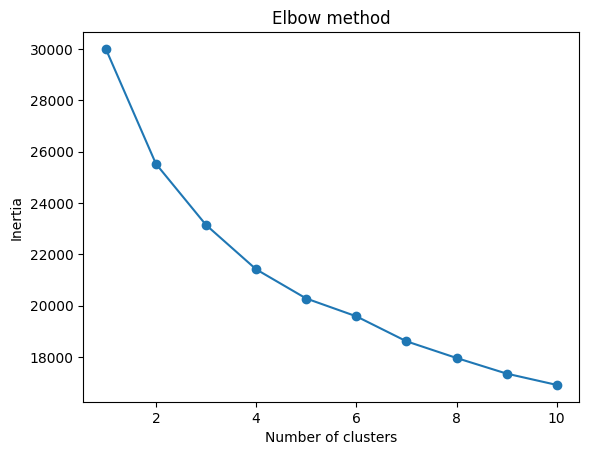

In [ ]:
df5 = df.copy()
df5 = df5[df5['Games Product'] != 'No internet service']
df5 = df5.drop(columns=['Customer ID'])
scaler = MinMaxScaler()
columns_to_normalize = ["Tenure Months","Monthly Purchase (Thou. IDR)","CLTV (Predicted Thou. IDR)"]
df5[columns_to_normalize] = scaler.fit_transform(df5[columns_to_normalize])
inertias = []
object_columns = df5.select_dtypes(include=['object'])
object_columns = object_columns.columns.tolist()
df5 = pd.get_dummies(df5, columns=object_columns)

for i in range(1,11):
    kmeans = KMeans(n_clusters=i)
    kmeans.fit(df5)
    inertias.append(kmeans.inertia_)

plt.plot(range(1,11), inertias, marker='o')
plt.title('Elbow method')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


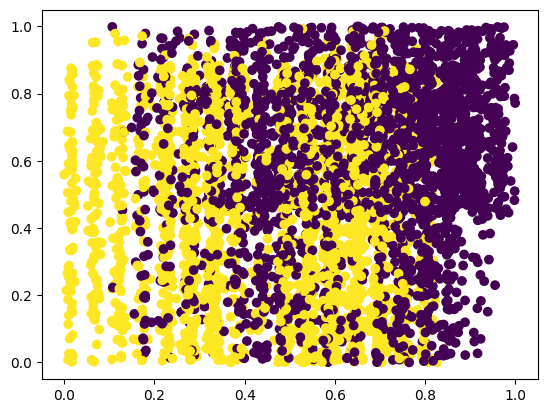

In [ ]:
kmeans = KMeans(n_clusters=2)
kmeans.fit(df5)
y = df5['CLTV (Predicted Thou. IDR)']
x = df5['Monthly Purchase (Thou. IDR)']

plt.scatter(x, y, c=kmeans.labels_)
plt.show()

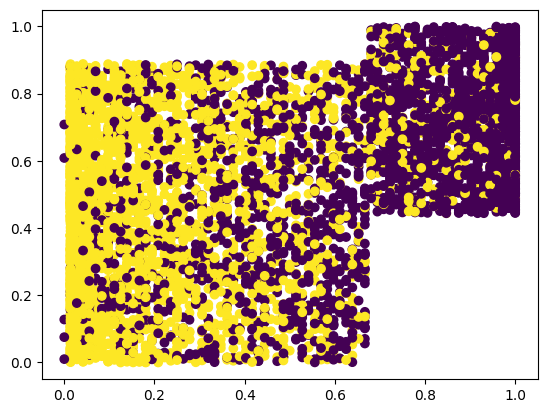

In [ ]:
y = df5['CLTV (Predicted Thou. IDR)']
x = df5['Tenure Months']

plt.scatter(x, y, c=kmeans.labels_)
plt.show()

In [ ]:
cluster_labels = kmeans.fit_predict(df5)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [ ]:
df5['Cluster'] = cluster_labels

In [ ]:
silhouette_avg = silhouette_score(df5, cluster_labels)
print("Silhouette Score:", silhouette_avg)

Silhouette Score: 0.1789738295917122


<Axes: xlabel='Device Class_High End', ylabel='count'>

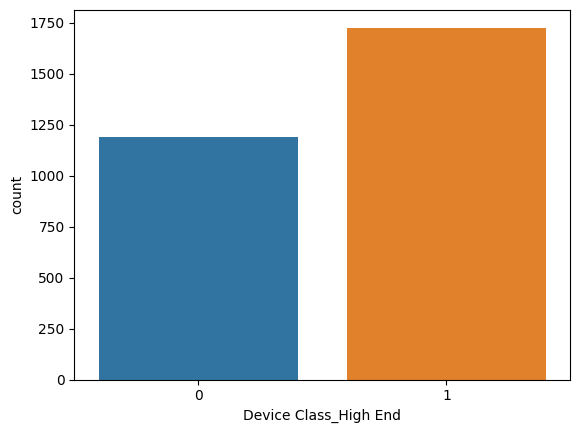

In [ ]:
sns.countplot(data=df5[df5['Cluster'] == 0], x="Device Class_High End")

<Axes: xlabel='Device Class_High End', ylabel='count'>

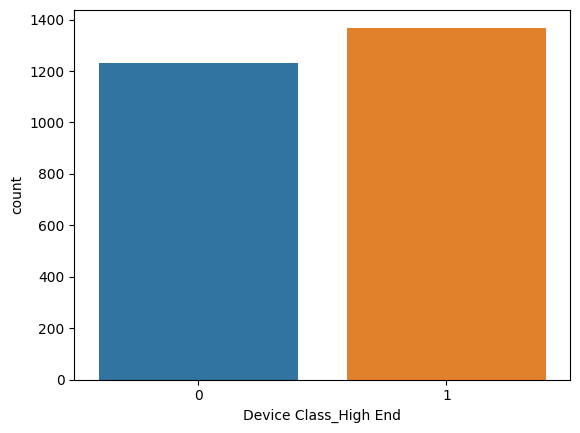

In [ ]:
sns.countplot(data=df5[df5['Cluster'] == 1], x="Device Class_High End")

In [ ]:
kmeans = KMeans(n_clusters=4)
kmeans.fit(df5)
cluster_labels = kmeans.fit_predict(df5)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [ ]:
df5['Cluster'] = cluster_labels

In [ ]:
df2 = df.copy()
df2 = df2[df2['Games Product'] != 'No internet service']

In [ ]:
df2['Cluster'] = cluster_labels

In [ ]:
df2.to_excel('clustered_telco.xlsx')

In [ ]:
from sklearn.decomposition import PCA

In [ ]:
df2 = pd.read_excel('clustered_telco.xlsx')

In [ ]:
df2 = df2.drop(columns=['Customer ID'])
scaler = MinMaxScaler()
df2[['Games Product','Music Product','Education Product','Call Center','Video Product','Use MyApp','Churn Label']] = (df2[['Games Product','Music Product','Education Product','Call Center','Video Product','Use MyApp','Churn Label']] == 'Yes').astype(int)
df2['Location'] = (df2['Location'] == 'Jakarta').astype(int)
df2['Device Class'] = (df2['Device Class'] == 'High End').astype(int)
df2 = pd.get_dummies(df2, columns=['Payment Method'])

In [ ]:
# Extract the features you want to perform PCA on (assuming numeric columns)
X = df2.drop(columns=['Cluster'])  # Replace with the actual column names

# Extract cluster labels
labels = df2['Cluster']

# Perform PCA to reduce data to 2D
pca = PCA(n_components=2)
X_2d = pca.fit_transform(X)

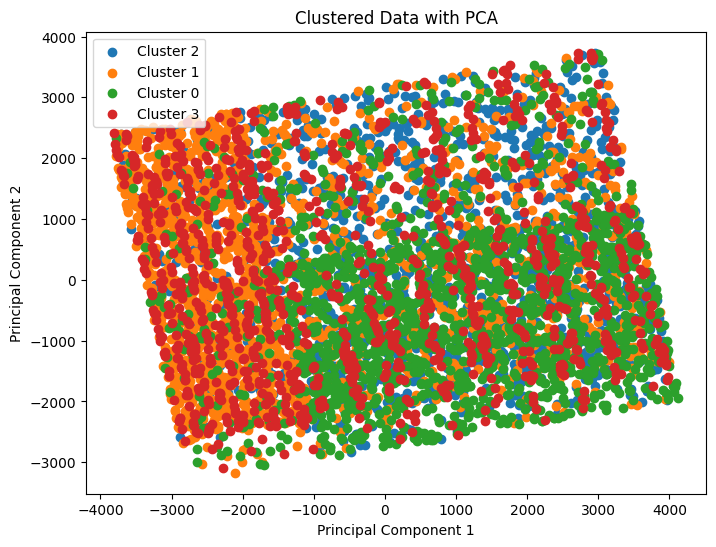

In [ ]:
# Create a scatter plot with colors for clusters
plt.figure(figsize=(8, 6))
unique_labels = labels.unique()
for label in unique_labels:
    plt.scatter(X_2d[labels == label, 0], X_2d[labels == label, 1], label=f'Cluster {label}')

plt.title('Clustered Data with PCA')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend()

plt.show()

In [ ]:
# Extract the features you want to perform PCA on (assuming numeric columns)
X = df2[['Tenure Months','Monthly Purchase (Thou. IDR)']]  # Replace with the actual column names

# Extract cluster labels
labels = df2['Cluster']

# Perform PCA to reduce data to 2D
pca = PCA(n_components=2)
X_2d = pca.fit_transform(X)

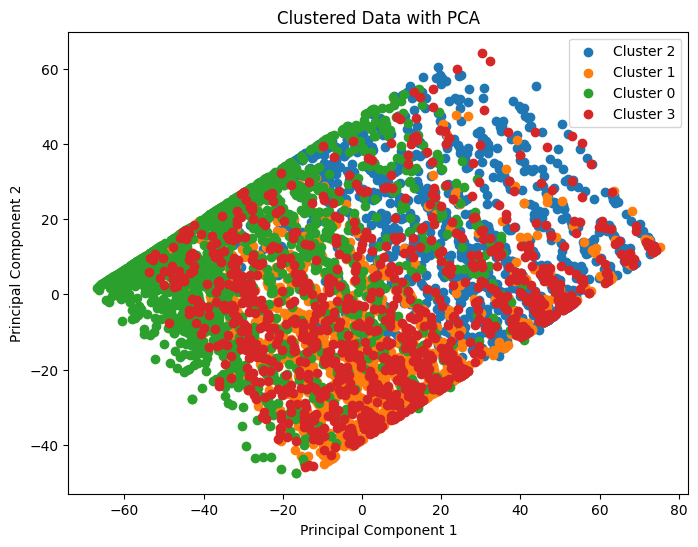

In [ ]:
# Create a scatter plot with colors for clusters
plt.figure(figsize=(8, 6))
unique_labels = labels.unique()
for label in unique_labels:
    plt.scatter(X_2d[labels == label, 0], X_2d[labels == label, 1], label=f'Cluster {label}')

plt.title('Clustered Data with PCA')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend()

plt.show()

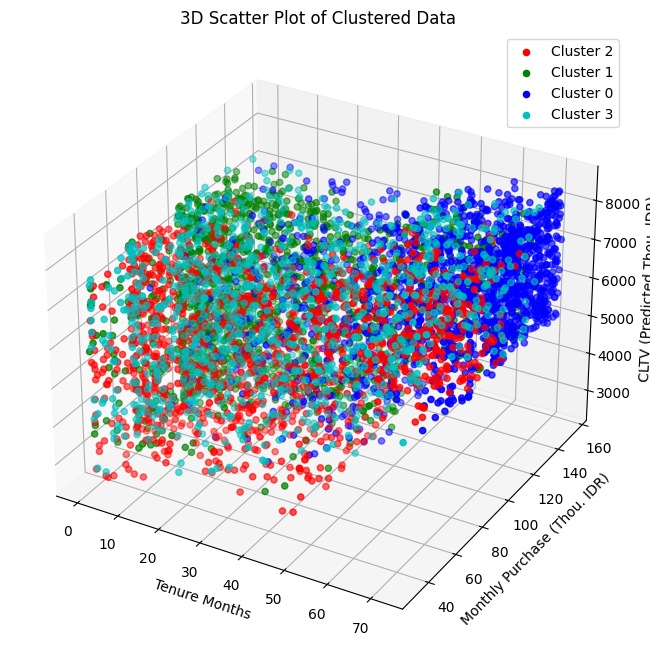

In [ ]:
df = pd.read_excel('clustered_telco.xlsx')
df = df.drop(columns=['Customer ID'])
scaler = MinMaxScaler()
df[['Games Product','Music Product','Education Product','Call Center','Video Product','Use MyApp','Churn Label']] = (df[['Games Product','Music Product','Education Product','Call Center','Video Product','Use MyApp','Churn Label']] == 'Yes').astype(int)
df['Location'] = (df['Location'] == 'Jakarta').astype(int)
df['Device Class'] = (df['Device Class'] == 'High End').astype(int)
df = pd.get_dummies(df, columns=['Payment Method'])

# Extract features and cluster labels
X = df[['Tenure Months','Monthly Purchase (Thou. IDR)', 'CLTV (Predicted Thou. IDR)']]  # Replace with actual feature columns
labels = df['Cluster']

# Create a 3D scatter plot
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Define unique cluster labels
unique_labels = labels.unique()

# Assign different colors to clusters
colors = ['r', 'g', 'b', 'c', 'm', 'y', 'k']

# Plot each cluster separately
for i, label in enumerate(unique_labels):
    cluster_data = X[labels == label]
    ax.scatter(cluster_data['Tenure Months'], cluster_data['Monthly Purchase (Thou. IDR)'], cluster_data['CLTV (Predicted Thou. IDR)'],
               c=colors[i], label=f'Cluster {label}')

ax.set_xlabel('Tenure Months')
ax.set_ylabel('Monthly Purchase (Thou. IDR)')
ax.set_zlabel('CLTV (Predicted Thou. IDR)')
ax.set_title('3D Scatter Plot of Clustered Data')
ax.legend()

plt.show()

# Decision Tree (Tenure Months)

In [ ]:
df['Tenure Category'] = df['Tenure Months'].apply(lambda x: 0 if x < 29 else 1)

<Axes: xlabel='Tenure Category', ylabel='count'>

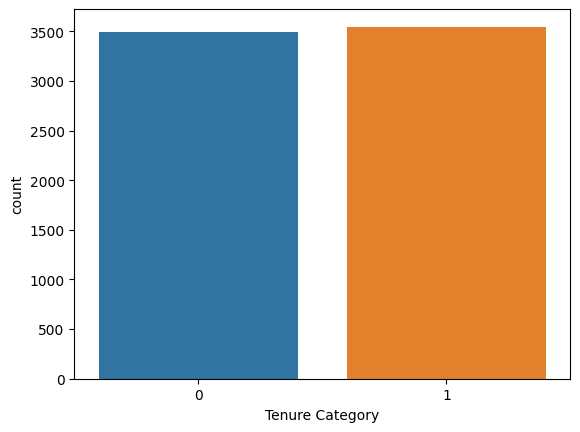

In [ ]:
sns.countplot(data=df, x="Tenure Category")

In [ ]:
len(df[df['Tenure Category'] == 0])

3497

In [ ]:
len(df[df['Tenure Category'] == 1])

3546

In [ ]:
df = pd.read_excel('Telco_customer_churn_adapted_v2.xlsx')
df['Tenure Category'] = df['Tenure Months'].apply(lambda x: 0 if x < 29 else 1)
df = df.drop(columns=['Longitude', 'Latitude', 'Customer ID'])
scaler = MinMaxScaler()
columns_to_normalize = ["Tenure Months","Monthly Purchase (Thou. IDR)","CLTV (Predicted Thou. IDR)"]
df[columns_to_normalize] = scaler.fit_transform(df[columns_to_normalize])
object_columns = df.select_dtypes(include=['object'])
object_columns = object_columns.columns.tolist()
df = pd.get_dummies(df, columns=object_columns)

In [ ]:
X = df.drop(columns=['Tenure Months','Tenure Category'])
y = df['Tenure Category']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1)

In [ ]:
clf = DecisionTreeClassifier()
clf = clf.fit(X_train,y_train)
y_pred = clf.predict(X_test)

In [ ]:
metrics.accuracy_score(y_test, y_pred)

0.6966398485565547

In [ ]:
dot_data = StringIO()
export_graphviz(clf, out_file=dot_data,
                filled=True, rounded=True,
                special_characters=True,feature_names = X.columns,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('tenure.png')
Image(graph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.433088 to fit

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.433088 to fit



In [ ]:
df = pd.read_excel('Telco_customer_churn_adapted_v2.xlsx')
df['Tenure Category'] = df['Tenure Months'].apply(lambda x: 0 if x < 29 else 1)
df = df.drop(columns=['Longitude', 'Latitude', 'Customer ID'])
df = df.drop(columns=["Tenure Months","Monthly Purchase (Thou. IDR)","CLTV (Predicted Thou. IDR)"])
object_columns = df.select_dtypes(include=['object'])
object_columns = object_columns.columns.tolist()
df = pd.get_dummies(df, columns=object_columns)

In [ ]:
X = df.drop(columns=['Tenure Category'])
y = df['Tenure Category']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1)

In [ ]:
clf = DecisionTreeClassifier()
clf = clf.fit(X_train,y_train)
y_pred = clf.predict(X_test)

In [ ]:
metrics.accuracy_score(y_test, y_pred)

0.7103644107903455

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.370437 to fit

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.370437 to fit



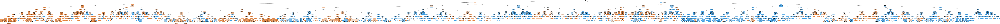

In [ ]:
dot_data = StringIO()
export_graphviz(clf, out_file=dot_data,
                filled=True, rounded=True,
                special_characters=True,feature_names = X.columns,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('tenure.png')
Image(graph.create_png())

In [ ]:
df

,Tenure Category,Location_Bandung,Location_Jakarta,Device Class_High End,Device Class_Low End,Device Class_Mid End,Games Product_No,Games Product_No internet service,Games Product_Yes,Music Product_No,...,Video Product_Yes,Use MyApp_No,Use MyApp_No internet service,Use MyApp_Yes,Payment Method_Credit,Payment Method_Debit,Payment Method_Digital Wallet,Payment Method_Pulsa,Churn Label_No,Churn Label_Yes
0,0,0,1,0,0,1,0,0,1,0,...,0,1,0,0,0,0,1,0,0,1
1,0,0,1,1,0,0,1,0,0,1,...,0,1,0,0,0,0,0,1,0,1
2,0,0,1,1,0,0,1,0,0,1,...,1,0,0,1,0,0,0,1,0,1
3,0,0,1,1,0,0,1,0,0,1,...,1,0,0,1,0,0,0,1,0,1
4,1,0,1,1,0,0,1,0,0,0,...,1,0,0,1,0,1,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7038,1,0,1,0,1,0,0,1,0,0,...,0,0,1,0,0,1,0,0,1,0
7039,0,0,1,0,0,1,0,0,1,1,...,1,0,0,1,0,0,1,0,1,0
7040,1,0,1,1,0,0,1,0,0,0,...,1,0,0,1,1,0,0,0,1,0
7041,0,0,1,0,0,1,0,0,1,1,...,0,1,0,0,0,0,0,1,1,0


# Decision Tree (Churn Label)

In [ ]:
df = pd.read_excel('Telco_customer_churn_adapted_v2.xlsx')
df = df.drop(columns=['Longitude', 'Latitude', 'Customer ID'])
scaler = MinMaxScaler()
columns_to_normalize = ["Tenure Months","Monthly Purchase (Thou. IDR)","CLTV (Predicted Thou. IDR)"]
df[columns_to_normalize] = scaler.fit_transform(df[columns_to_normalize])
object_columns = df.select_dtypes(include=['object'])
object_columns = object_columns.columns.tolist()
df = pd.get_dummies(df, columns=object_columns)

In [ ]:
df

,Tenure Months,Monthly Purchase (Thou. IDR),CLTV (Predicted Thou. IDR),Location_Bandung,Location_Jakarta,Device Class_High End,Device Class_Low End,Device Class_Mid End,Games Product_No,Games Product_No internet service,...,Video Product_Yes,Use MyApp_No,Use MyApp_No internet service,Use MyApp_Yes,Payment Method_Credit,Payment Method_Debit,Payment Method_Digital Wallet,Payment Method_Pulsa,Churn Label_No,Churn Label_Yes
0,0.027778,0.354229,0.274850,0,1,0,0,1,0,0,...,0,1,0,0,0,0,1,0,0,1
1,0.027778,0.521891,0.155215,0,1,1,0,0,1,0,...,0,1,0,0,0,0,0,1,0,1
2,0.111111,0.809950,0.749166,0,1,1,0,0,1,0,...,1,0,0,1,0,0,0,1,0,1
3,0.388889,0.861194,0.667111,0,1,1,0,0,1,0,...,1,0,0,1,0,0,0,1,0,1
4,0.680556,0.850249,0.742050,0,1,1,0,0,1,0,...,1,0,0,1,0,1,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7038,1.000000,0.028856,0.734490,0,1,0,1,0,0,1,...,0,0,1,0,0,1,0,0,1,0
7039,0.333333,0.662189,0.030465,0,1,0,0,1,0,0,...,1,0,0,1,0,0,1,0,1,0
7040,1.000000,0.845274,0.790972,0,1,1,0,0,1,0,...,1,0,0,1,1,0,0,0,1,0
7041,0.152778,0.112935,0.175673,0,1,0,0,1,0,0,...,0,1,0,0,0,0,0,1,1,0


In [ ]:
X = df.drop(columns=['Churn Label_No','Churn Label_Yes'])
y = df['Churn Label_Yes']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1)

## max_depth = 2

In [ ]:
clf = DecisionTreeClassifier(max_depth = 2)
clf = clf.fit(X_train,y_train)
y_pred = clf.predict(X_test)

In [ ]:
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

              precision    recall  f1-score   support

           0       0.84      0.87      0.85      1575
           1       0.56      0.51      0.53       538

    accuracy                           0.77      2113
   macro avg       0.70      0.69      0.69      2113
weighted avg       0.77      0.77      0.77      2113

Confusion matrix, without normalization
[[1363  212]
 [ 265  273]]


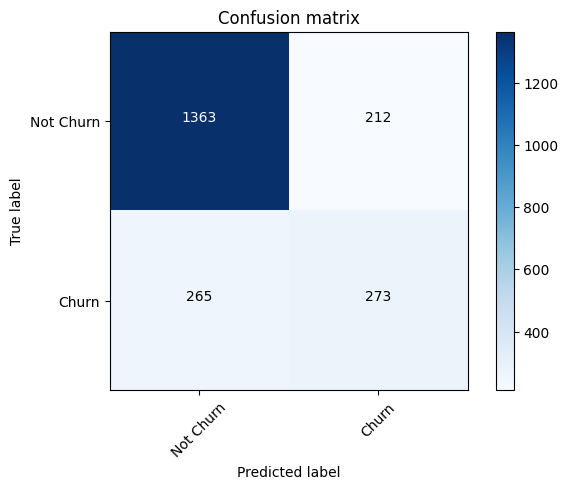

In [ ]:
cnf_matrix = confusion_matrix(y_test, y_pred, labels=[0,1])
np.set_printoptions(precision=2)
print (classification_report(y_test, y_pred))
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=['Not Churn','Churn'],normalize= False,  title='Confusion matrix')

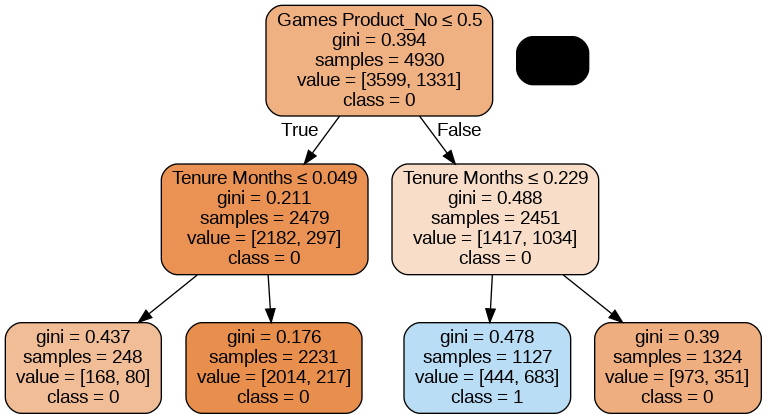

In [ ]:
dot_data = StringIO()
export_graphviz(clf, out_file=dot_data,
                filled=True, rounded=True,
                special_characters=True,feature_names = X.columns,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('tenure.png')
Image(graph.create_png())

## max_depth = 5

In [ ]:
clf = DecisionTreeClassifier(max_depth = 5)
clf = clf.fit(X_train,y_train)
y_pred = clf.predict(X_test)

              precision    recall  f1-score   support

           0       0.84      0.88      0.86      1575
           1       0.59      0.52      0.55       538

    accuracy                           0.79      2113
   macro avg       0.72      0.70      0.71      2113
weighted avg       0.78      0.79      0.78      2113

Confusion matrix, without normalization
[[1384  191]
 [ 259  279]]


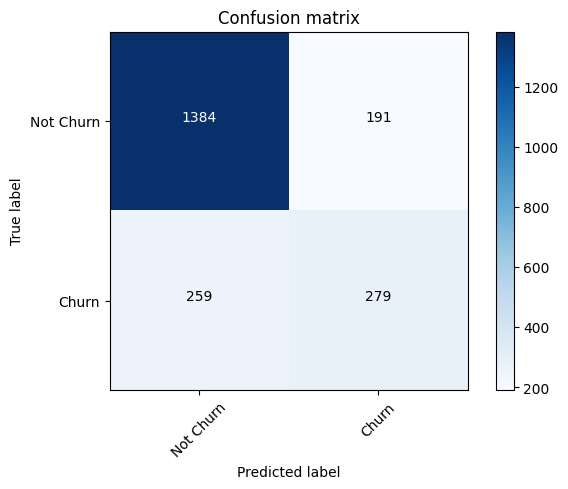

In [ ]:
cnf_matrix = confusion_matrix(y_test, y_pred, labels=[0,1])
np.set_printoptions(precision=2)
print (classification_report(y_test, y_pred))
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=['Not Churn','Churn'],normalize= False,  title='Confusion matrix')

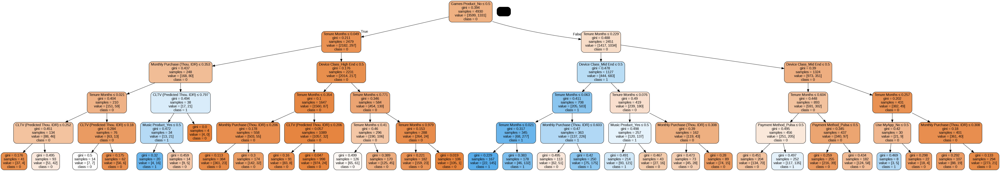

In [ ]:
dot_data = StringIO()
export_graphviz(clf, out_file=dot_data,
                filled=True, rounded=True,
                special_characters=True,feature_names = X.columns,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('tenure.png')
Image(graph.create_png())

## Undersampling, max_depth = 5

In [ ]:
rus = RandomUnderSampler(random_state=42)
X_res, y_res = rus.fit_resample(X_train, y_train)

In [ ]:
clf = DecisionTreeClassifier(max_depth = 5)
clf = clf.fit(X_res,y_res)
y_pred = clf.predict(X_test)

              precision    recall  f1-score   support

           0       0.89      0.73      0.80      1575
           1       0.48      0.73      0.58       538

    accuracy                           0.73      2113
   macro avg       0.68      0.73      0.69      2113
weighted avg       0.79      0.73      0.75      2113

Confusion matrix, without normalization
[[1148  427]
 [ 143  395]]


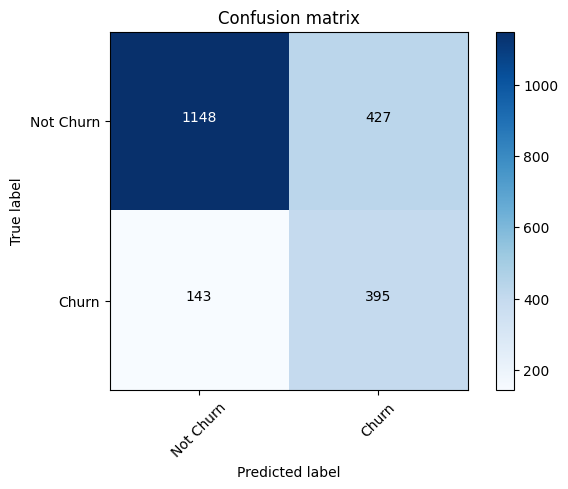

In [ ]:
cnf_matrix = confusion_matrix(y_test, y_pred, labels=[0,1])
np.set_printoptions(precision=2)
print (classification_report(y_test, y_pred))
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=['Not Churn','Churn'],normalize= False,  title='Confusion matrix')

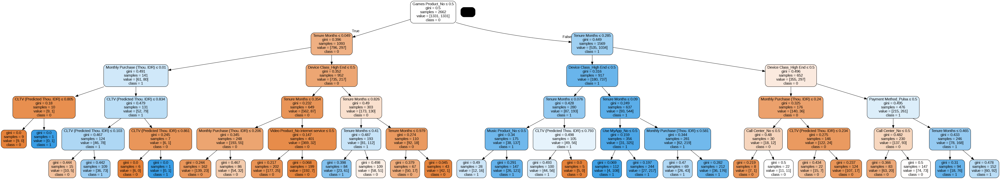

In [ ]:
dot_data = StringIO()
export_graphviz(clf, out_file=dot_data,
                filled=True, rounded=True,
                special_characters=True,feature_names = X.columns,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('tenure.png')
Image(graph.create_png())

## Undersampling, max_depth = 2

In [ ]:
clf = DecisionTreeClassifier(max_depth = 2)
clf = clf.fit(X_res,y_res)
y_pred = clf.predict(X_test)

              precision    recall  f1-score   support

           0       0.85      0.80      0.82      1575
           1       0.50      0.58      0.54       538

    accuracy                           0.75      2113
   macro avg       0.67      0.69      0.68      2113
weighted avg       0.76      0.75      0.75      2113

Confusion matrix, without normalization
[[1261  314]
 [ 224  314]]


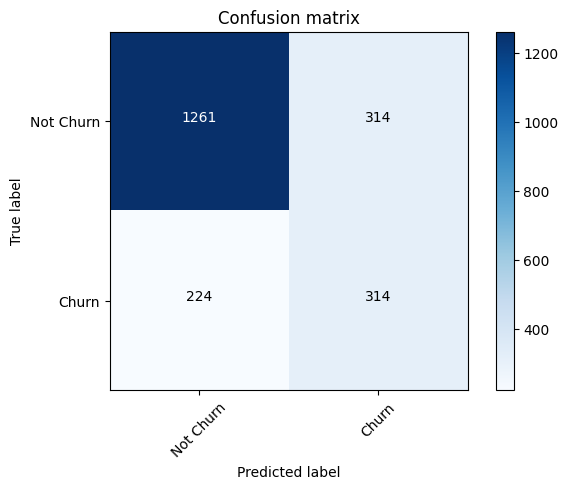

In [ ]:
cnf_matrix = confusion_matrix(y_test, y_pred, labels=[0,1])
np.set_printoptions(precision=2)
print (classification_report(y_test, y_pred))
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=['Not Churn','Churn'],normalize= False,  title='Confusion matrix')

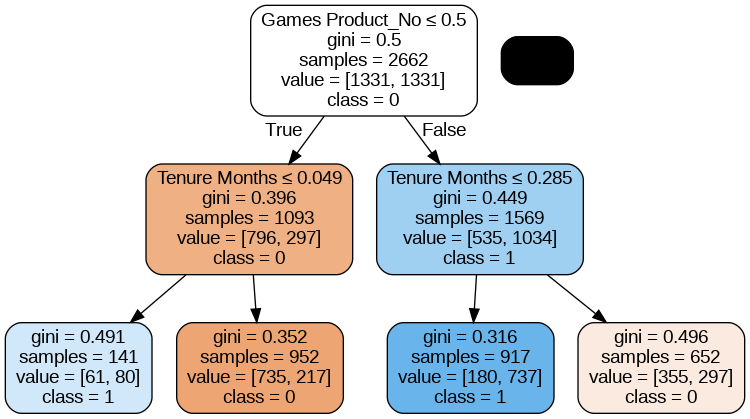

In [ ]:
dot_data = StringIO()
export_graphviz(clf, out_file=dot_data,
                filled=True, rounded=True,
                special_characters=True,feature_names = X.columns,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('tenure.png')
Image(graph.create_png())

## Oversampling, max_depth = 5 (highest recall & f1-score)

In [ ]:
sm = SMOTE(random_state=42)
X_res, y_res = sm.fit_resample(X_train, y_train)

In [ ]:
clf = DecisionTreeClassifier(max_depth = 5)
clf = clf.fit(X_res,y_res)
y_pred = clf.predict(X_test)

              precision    recall  f1-score   support

           0       0.89      0.71      0.79      1575
           1       0.47      0.74      0.58       538

    accuracy                           0.72      2113
   macro avg       0.68      0.73      0.68      2113
weighted avg       0.78      0.72      0.74      2113

Confusion matrix, without normalization
[[1126  449]
 [ 139  399]]


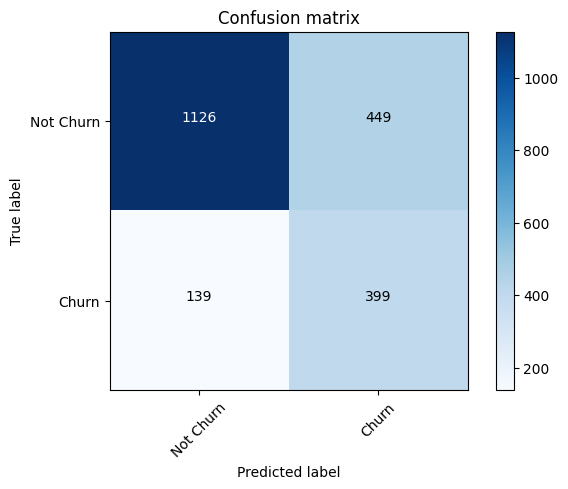

In [ ]:
cnf_matrix = confusion_matrix(y_test, y_pred, labels=[0,1])
np.set_printoptions(precision=2)
print (classification_report(y_test, y_pred))
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=['Not Churn','Churn'],normalize= False,  title='Confusion matrix')

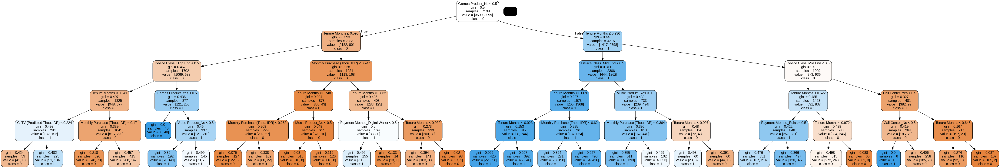

In [ ]:
dot_data = StringIO()
export_graphviz(clf, out_file=dot_data,
                filled=True, rounded=True,
                special_characters=True,feature_names = X.columns,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('tenure.png')
Image(graph.create_png())

## Oversampling, max_depth = 2

In [ ]:
clf = DecisionTreeClassifier(max_depth = 2)
clf = clf.fit(X_res,y_res)
y_pred = clf.predict(X_test)

              precision    recall  f1-score   support

           0       0.84      0.87      0.85      1575
           1       0.56      0.51      0.53       538

    accuracy                           0.77      2113
   macro avg       0.70      0.69      0.69      2113
weighted avg       0.77      0.77      0.77      2113

Confusion matrix, without normalization
[[1363  212]
 [ 265  273]]


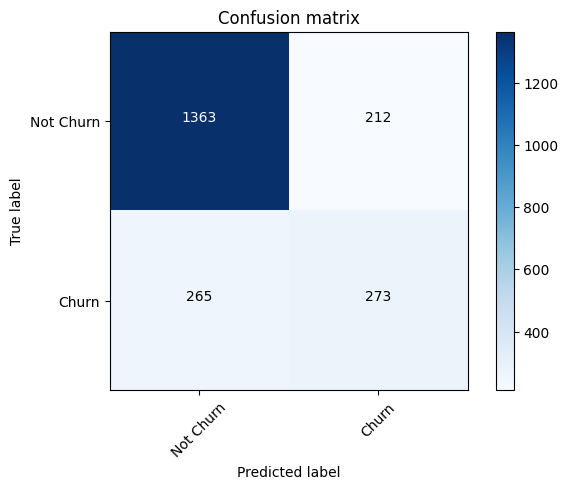

In [ ]:
cnf_matrix = confusion_matrix(y_test, y_pred, labels=[0,1])
np.set_printoptions(precision=2)
print (classification_report(y_test, y_pred))
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=['Not Churn','Churn'],normalize= False,  title='Confusion matrix')

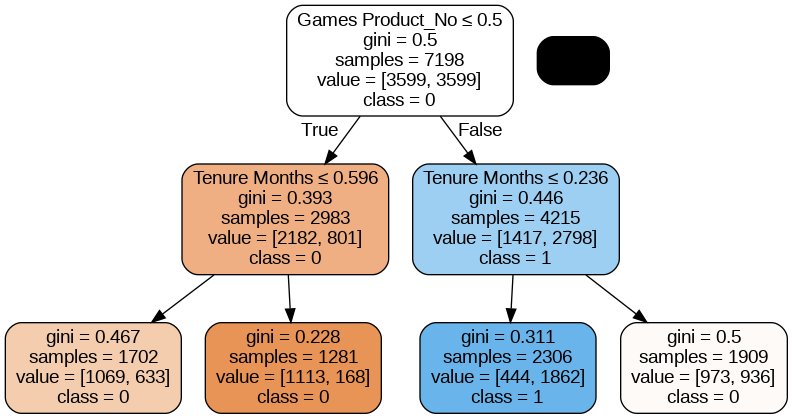

In [ ]:
dot_data = StringIO()
export_graphviz(clf, out_file=dot_data,
                filled=True, rounded=True,
                special_characters=True,feature_names = X.columns,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('tenure.png')
Image(graph.create_png())

# Multiple Classifier (Churn Label)

In [ ]:
df = pd.read_excel('Telco_customer_churn_adapted_v2.xlsx')
df = df.drop(columns=['Longitude', 'Latitude', 'Customer ID'])
scaler = MinMaxScaler()
columns_to_normalize = ["Tenure Months","Monthly Purchase (Thou. IDR)","CLTV (Predicted Thou. IDR)"]
df[columns_to_normalize] = scaler.fit_transform(df[columns_to_normalize])
df = df[df['Games Product'] != 'No internet service']
df[['Games Product','Music Product','Education Product','Call Center','Video Product','Use MyApp','Churn Label']] = (df[['Games Product','Music Product','Education Product','Call Center','Video Product','Use MyApp','Churn Label']] == 'Yes').astype(int)
df['Location'] = (df['Location'] == 'Jakarta').astype(int)
df['Device Class'] = (df['Device Class'] == 'High End').astype(int)
df = pd.get_dummies(df, columns=['Payment Method'])

In [ ]:
X = df.drop(columns=['Churn Label'])
y = df['Churn Label']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1)

In [ ]:
sm = SMOTE(random_state=42)
X_res, y_res = sm.fit_resample(X_train, y_train)

## With Cross-Validation

In [ ]:
classifiers = {
    "Random Forest": RandomForestClassifier(),
    "SVM": SVC(),
    "Logistic Regression": LogisticRegression(),
    "K-Nearest Neighbors": KNeighborsClassifier(),
    "Naive Bayes": GaussianNB()
}

In [ ]:
f1_scores = {}
recalls = {}
scoring = {'f1_score': make_scorer(f1_score), 'recall': make_scorer(recall_score)}

for name, clf in classifiers.items():
    cv_results = cross_validate(clf, X_res, y_res, cv=5, scoring=scoring)

    f1 = cv_results['test_f1_score'].mean()
    recall = cv_results['test_recall'].mean()

    f1_scores[name] = f1
    recalls[name] = recall

In [ ]:
for name in classifiers.keys():
    print(f"{name} - F1 Score: {f1_scores[name]}, Recall: {recalls[name]}")

Random Forest - F1 Score: 0.8043070811040411, Recall: 0.8262858662526595
SVM - F1 Score: 0.7646030185062405, Recall: 0.8084353976194583
Logistic Regression - F1 Score: 0.7467519043456421, Recall: 0.7647957276752344
K-Nearest Neighbors - F1 Score: 0.7724641349463692, Recall: 0.8387901788281296
Naive Bayes - F1 Score: 0.7397342913518059, Recall: 0.7575922891150595


In [ ]:
classifiers = {
    "Decision Tree": DecisionTreeClassifier(),
    "Gradient Boosting": GradientBoostingClassifier(),
    "XGBoost": XGBClassifier(),
    "MLP Classifier": MLPClassifier(),
    "LGBM Classifier": LGBMClassifier(),
    "SGD Classifier": SGDClassifier(),
    "AdaBoost Classifier": AdaBoostClassifier()
}

In [ ]:
f1_scores = {}
recalls = {}
scoring = {'f1_score': make_scorer(f1_score), 'recall': make_scorer(recall_score)}

for name, clf in classifiers.items():
    cv_results = cross_validate(clf, X_res, y_res, cv=5, scoring=scoring)

    f1 = cv_results['test_f1_score'].mean()
    recall = cv_results['test_recall'].mean()

    f1_scores[name] = f1
    recalls[name] = recall

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptro

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 2108, number of negative: 2109
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000830 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 788
[LightGBM] [Info] Number of data points in the train set: 4217, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.499881 -> initscore=-0.000474
[LightGBM] [Info] Start training from score -0.000474
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 2109, number of negative: 2108
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000897 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wis

In [ ]:
for name in classifiers.keys():
    print(f"{name} - F1 Score: {f1_scores[name]}, Recall: {recalls[name]}")

Decision Tree - F1 Score: 0.7277437757133067, Recall: 0.7401730780288654
Gradient Boosting - F1 Score: 0.7687249612265802, Recall: 0.7951605715600023
XGBoost - F1 Score: 0.7791786302198008, Recall: 0.7963192168362947
MLP Classifier - F1 Score: 0.7677773426474619, Recall: 0.7947774711057444
LGBM Classifier - F1 Score: 0.781348211788362, Recall: 0.8042874187798287
SGD Classifier - F1 Score: 0.7540046078896439, Recall: 0.8000654073946294
AdaBoost Classifier - F1 Score: 0.7622471237932074, Recall: 0.7890891840607211


## Without Cross-Validation

In [ ]:
classifiers = {
    "Random Forest": RandomForestClassifier(),
    "SVM": SVC(),
    "Logistic Regression": LogisticRegression(),
    "K-Nearest Neighbors": KNeighborsClassifier(),
    "Naive Bayes": GaussianNB()
}

In [ ]:
f1_scores = {}
recalls = {}

for name, clf in classifiers.items():
    clf.fit(X_res, y_res)
    y_pred = clf.predict(X_test)
    recall = recall_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    f1_scores[name] = f1
    recalls[name] = recall

In [ ]:
for name in classifiers.keys():
    print(f"{name} - F1 Score: {f1_scores[name]}, Recall: {recalls[name]}")

Random Forest - F1 Score: 0.5770258236865539, Recall: 0.6101694915254238
SVM - F1 Score: 0.6193853427895981, Recall: 0.7401129943502824
Logistic Regression - F1 Score: 0.6414790996784565, Recall: 0.751412429378531
K-Nearest Neighbors - F1 Score: 0.5536, Recall: 0.6516007532956686
Naive Bayes - F1 Score: 0.6225806451612903, Recall: 0.7269303201506592


In [ ]:
classifiers = {
    "Decision Tree": DecisionTreeClassifier(),
    "Gradient Boosting": GradientBoostingClassifier(),
    "XGBoost": XGBClassifier(),
    "MLP Classifier": MLPClassifier(),
    "LGBM Classifier": LGBMClassifier(),
    "SGD Classifier": SGDClassifier(),
    "AdaBoost Classifier": AdaBoostClassifier()
}

In [ ]:
f1_scores = {}
recalls = {}

for name, clf in classifiers.items():
    clf.fit(X_res, y_res)
    y_pred = clf.predict(X_test)
    recall = recall_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    f1_scores[name] = f1
    recalls[name] = recall

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 2636, number of negative: 2636
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001095 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 788
[LightGBM] [Info] Number of data points in the train set: 5272, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000


In [ ]:
for name in classifiers.keys():
    print(f"{name} - F1 Score: {f1_scores[name]}, Recall: {recalls[name]}")

Decision Tree - F1 Score: 0.5056669572798606, Recall: 0.5461393596986818
Gradient Boosting - F1 Score: 0.6246973365617433, Recall: 0.7288135593220338
XGBoost - F1 Score: 0.5789014821272885, Recall: 0.6252354048964218
MLP Classifier - F1 Score: 0.6040268456375839, Recall: 0.6779661016949152
LGBM Classifier - F1 Score: 0.6038687973086626, Recall: 0.6760828625235404
SGD Classifier - F1 Score: 0.6442845723421263, Recall: 0.7589453860640302
AdaBoost Classifier - F1 Score: 0.6376582278481012, Recall: 0.7589453860640302


In [ ]:
clf = LogisticRegression()
clf = clf.fit(X_res,y_res)
y_pred = clf.predict(X_test)

              precision    recall  f1-score   support

           0       0.86      0.72      0.78      1125
           1       0.56      0.75      0.64       531

    accuracy                           0.73      1656
   macro avg       0.71      0.74      0.71      1656
weighted avg       0.76      0.73      0.74      1656

Confusion matrix, without normalization
[[811 314]
 [132 399]]


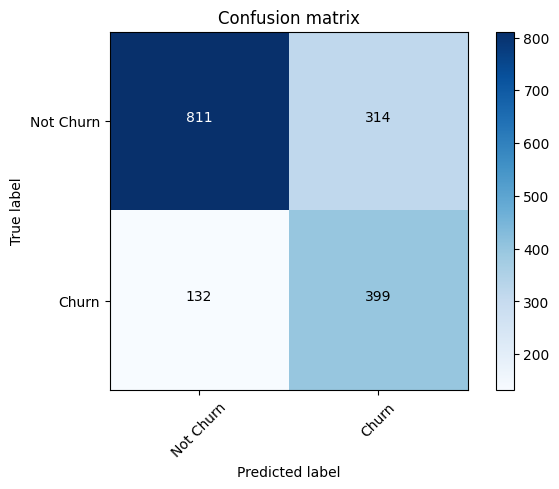

In [ ]:
cnf_matrix = confusion_matrix(y_test, y_pred, labels=[0,1])
np.set_printoptions(precision=2)
print (classification_report(y_test, y_pred))
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=['Not Churn','Churn'],normalize= False,  title='Confusion matrix')

In [ ]:
filename = 'churn_model.sav'
pickle.dump(clf, open(filename, 'wb'))

In [ ]:
filename = 'churn_model.sav'
loaded_model = pickle.load(open(filename, 'rb'))

In [ ]:
loaded_model.coef_

array([[-2.51297489, -0.21974097,  0.39702806, -0.71187067, -0.4376661 ,
        -0.31797304, -0.85802661,  0.04841144,  0.17972653,  1.87673616,
        -0.17324807, -0.07321614, -0.1285686 , -0.24928166,  0.45159489]])

In [ ]:
loaded_model.feature_names_in_

array(['Tenure Months', 'Location', 'Device Class', 'Games Product',
       'Music Product', 'Education Product', 'Call Center',
       'Video Product', 'Use MyApp', 'Monthly Purchase (Thou. IDR)',
       'CLTV (Predicted Thou. IDR)', 'Payment Method_Credit',
       'Payment Method_Debit', 'Payment Method_Digital Wallet',
       'Payment Method_Pulsa'], dtype=object)

In [ ]:
clf = SGDClassifier()
clf = clf.fit(X_res,y_res)
y_pred = clf.predict(X_test)

              precision    recall  f1-score   support

           0       0.84      0.78      0.81      1125
           1       0.59      0.68      0.63       531

    accuracy                           0.75      1656
   macro avg       0.71      0.73      0.72      1656
weighted avg       0.76      0.75      0.75      1656

Confusion matrix, without normalization
[[874 251]
 [171 360]]


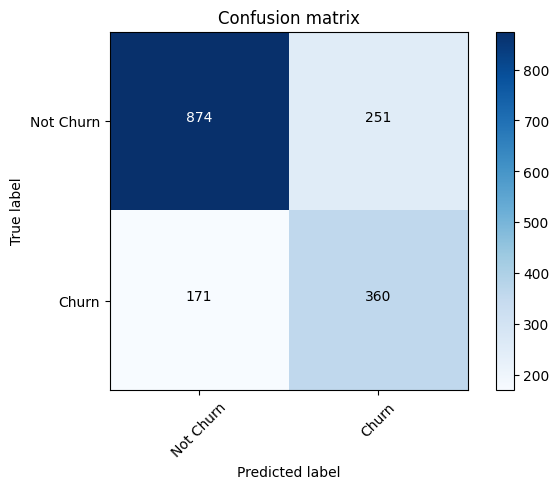

In [ ]:
cnf_matrix = confusion_matrix(y_test, y_pred, labels=[0,1])
np.set_printoptions(precision=2)
print (classification_report(y_test, y_pred))
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=['Not Churn','Churn'],normalize= False,  title='Confusion matrix')

In [ ]:
recall = recall_score(y_test, y_pred)

In [ ]:
recall

0.6779661016949152

In [ ]:
sfs = SequentialFeatureSelector(LogisticRegression(), n_features_to_select='auto')

In [ ]:
sfs.fit(X_res,y_res)

SequentialFeatureSelector(estimator=LogisticRegression(),
                          n_features_to_select='auto')

In [ ]:
clf = LogisticRegression()
clf = clf.fit(sfs.transform(X_res),y_res)
y_pred = clf.predict(sfs.transform(X_test))

              precision    recall  f1-score   support

           0       0.86      0.70      0.77      1125
           1       0.54      0.76      0.63       531

    accuracy                           0.72      1656
   macro avg       0.70      0.73      0.70      1656
weighted avg       0.76      0.72      0.73      1656

Confusion matrix, without normalization
[[787 338]
 [127 404]]


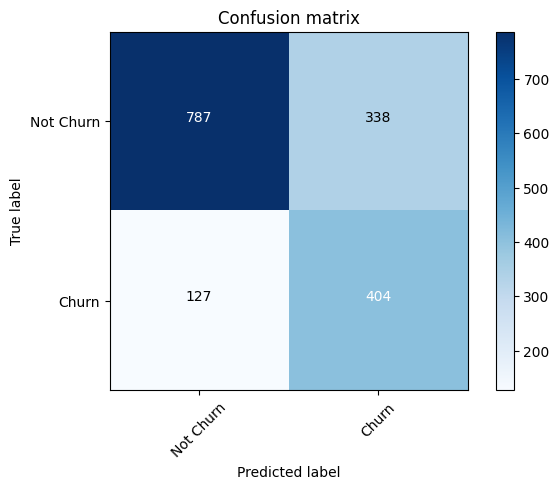

In [ ]:
cnf_matrix = confusion_matrix(y_test, y_pred, labels=[0,1])
np.set_printoptions(precision=2)
print (classification_report(y_test, y_pred))
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=['Not Churn','Churn'],normalize= False,  title='Confusion matrix')

In [ ]:
sfs.get_feature_names_out()

array(['Tenure Months', 'Location', 'Device Class', 'Education Product',
       'Call Center', 'Payment Method_Credit', 'Payment Method_Pulsa'],
      dtype=object)

In [ ]:
clf.coef_

array([[-2.66, -0.19,  1.18, -0.14, -0.76,  0.11,  0.7 ]])

In [ ]:
sfs = SequentialFeatureSelector(LogisticRegression(), n_features_to_select='auto', scoring='f1')

In [ ]:
sfs.fit(X_res,y_res)

SequentialFeatureSelector(estimator=LogisticRegression(),
                          n_features_to_select='auto', scoring='f1')

In [ ]:
clf = LogisticRegression()
clf = clf.fit(sfs.transform(X_res),y_res)
y_pred = clf.predict(sfs.transform(X_test))

              precision    recall  f1-score   support

           0       0.86      0.70      0.78      1125
           1       0.55      0.76      0.64       531

    accuracy                           0.72      1656
   macro avg       0.71      0.73      0.71      1656
weighted avg       0.76      0.72      0.73      1656

Confusion matrix, without normalization
[[792 333]
 [126 405]]


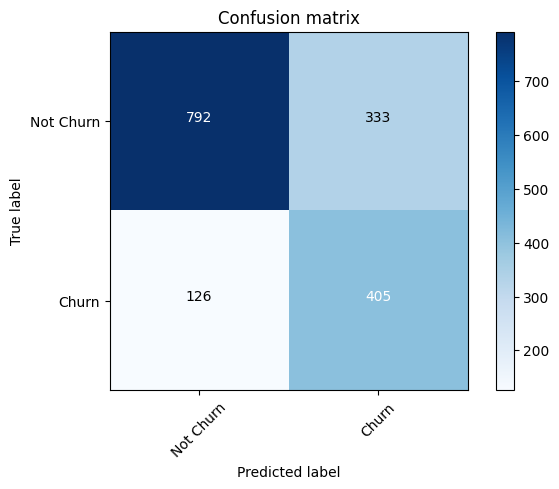

In [ ]:
cnf_matrix = confusion_matrix(y_test, y_pred, labels=[0,1])
np.set_printoptions(precision=2)
print (classification_report(y_test, y_pred))
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=['Not Churn','Churn'],normalize= False,  title='Confusion matrix')

In [ ]:
sfs.get_feature_names_out()

array(['Tenure Months', 'Device Class', 'Call Center', 'Video Product',
       'CLTV (Predicted Thou. IDR)', 'Payment Method_Credit',
       'Payment Method_Pulsa'], dtype=object)

In [ ]:
clf.coef_

array([[-2.87,  1.12, -0.81,  0.33, -0.17,  0.1 ,  0.67]])

## With Pipeline

In [ ]:
df = pd.read_excel('Telco_customer_churn_adapted_v2.xlsx')
df = df.drop(columns=['Longitude', 'Latitude', 'Customer ID'])
df = df[df['Games Product'] != 'No internet service']
X = df.drop(columns=['Churn Label'])
y = df['Churn Label']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1)

In [ ]:
X_train.sample(4)

,Tenure Months,Location,Device Class,Games Product,Music Product,Education Product,Call Center,Video Product,Use MyApp,Payment Method,Monthly Purchase (Thou. IDR),CLTV (Predicted Thou. IDR)
6608,35,Jakarta,High End,Yes,No,Yes,Yes,Yes,Yes,Pulsa,138.970,7081.1
6589,58,Jakarta,Mid End,Yes,Yes,No,No,Yes,No,Pulsa,58.955,6678.1
3479,29,Jakarta,Mid End,No,No,No,Yes,No,No,Pulsa,40.560,6189.3
1376,37,Bandung,High End,No,No,Yes,No,Yes,Yes,Pulsa,131.430,5751.2


In [ ]:
y_train.sample(4)

4063    No
4424    No
2563    No
5791    No
Name: Churn Label, dtype: object

In [ ]:
trf1 = ColumnTransformer([
    ('encoder',OneHotEncoder(sparse=False,handle_unknown='ignore'),slice(1,10))
])

In [ ]:
trf2 = MinMaxScaler()

In [ ]:
trf3 = SMOTE()

In [ ]:
trf4 = LogisticRegression()

In [ ]:
from sklearn.pipeline import Pipeline
pipe = imbpipeline(steps=[
    ('trf1',trf1),
    ('trf2',trf2),
    ('trf3',trf3),
    ('trf4',trf4)
])

In [ ]:
set_config(display='diagram')

In [ ]:
pipe.fit(X_train,y_train)

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:868: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(


Pipeline(steps=[('trf1',
                 ColumnTransformer(transformers=[('encoder',
                                                  OneHotEncoder(handle_unknown='ignore',
                                                                sparse=False),
                                                  slice(1, 10, None))])),
                ('trf2', MinMaxScaler()), ('trf3', SMOTE()),
                ('trf4', LogisticRegression())])

In [ ]:
y_pred = pipe.predict(X_test)

In [ ]:
y_pred

array(['No', 'No', 'Yes', ..., 'No', 'Yes', 'Yes'], dtype=object)

In [ ]:
y_test

3165     No
5203     No
1098    Yes
3540     No
4980     No
       ... 
249     Yes
3475     No
4816     No
1373    Yes
1381    Yes
Name: Churn Label, Length: 1656, dtype: object

In [ ]:
from sklearn.metrics import accuracy_score
accuracy_score(y_test,y_pred)

0.6871980676328503

In [ ]:
pickle.dump(pipe,open('pipe.pkl','wb'))

## False Positive Exploration

In [ ]:
false_positives = cnf_matrix[0, 1]
false_positive_data = X_test[(y_test == 0) & (y_pred == 1)]
false_positive_labels = y_test[(y_test == 0) & (y_pred == 1)]

In [ ]:
false_positive_data

,Tenure Months,Location,Device Class,Games Product,Music Product,Education Product,Call Center,Video Product,Use MyApp,Monthly Purchase (Thou. IDR),CLTV (Predicted Thou. IDR),Payment Method_Credit,Payment Method_Debit,Payment Method_Digital Wallet,Payment Method_Pulsa
4980,0.194444,0,1,0,0,0,0,0,0,0.565672,0.393151,0,0,0,1
4590,0.569444,1,1,0,0,1,0,1,1,0.794030,0.802980,0,1,0,0
2119,0.500000,1,1,0,1,0,0,1,1,0.761692,0.178786,1,0,0,0
6408,0.055556,1,1,0,0,0,0,0,0,0.521393,0.557483,0,0,0,1
2582,0.305556,0,1,0,0,0,0,1,1,0.764677,0.383811,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5110,0.416667,1,1,1,0,0,0,1,1,0.817413,0.394708,0,1,0,0
5994,0.236111,1,1,0,0,0,0,0,0,0.522886,0.759840,0,0,0,1
3408,0.027778,1,1,1,0,0,0,0,1,0.721393,0.614410,0,0,1,0
4278,0.013889,0,0,0,0,0,0,0,0,0.061194,0.253947,0,0,0,1


<Axes: xlabel='Location', ylabel='count'>

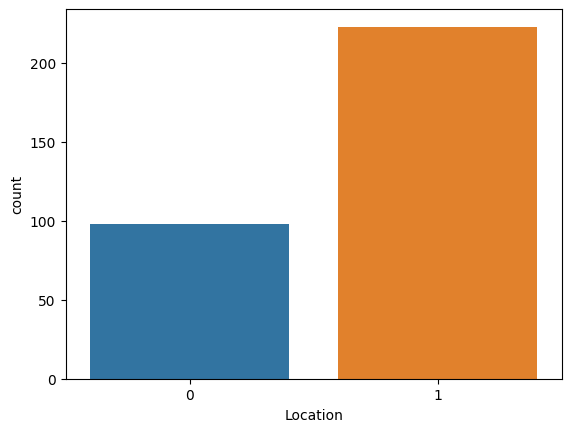

In [ ]:
sns.countplot(data=false_positive_data, x="Location")

<Axes: xlabel='Device Class', ylabel='count'>

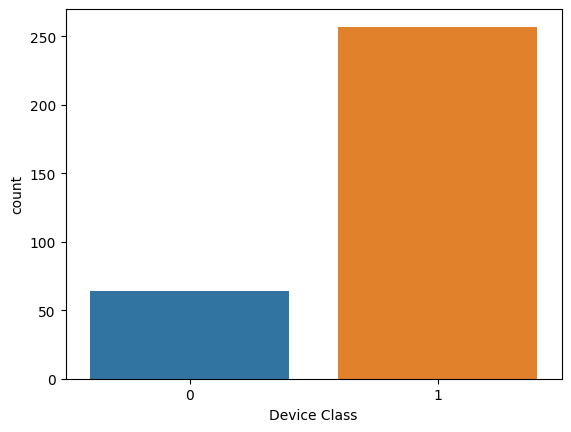

In [ ]:
sns.countplot(data=false_positive_data, x="Device Class")

<Axes: xlabel='Games Product', ylabel='count'>

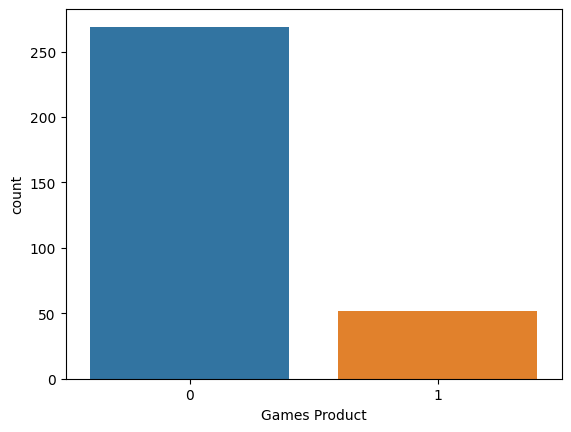

In [ ]:
sns.countplot(data=false_positive_data, x="Games Product")

<Axes: xlabel='Music Product', ylabel='count'>

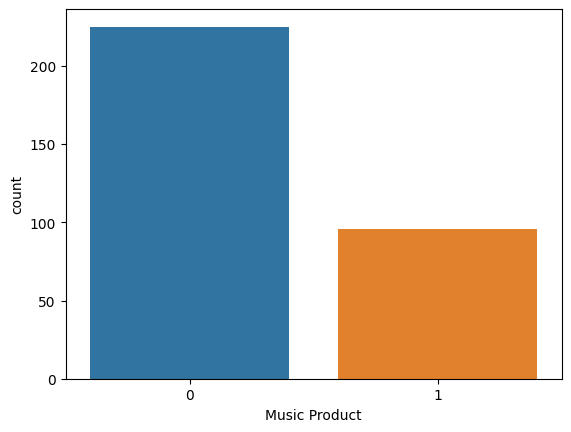

In [ ]:
sns.countplot(data=false_positive_data, x="Music Product")

<Axes: xlabel='Education Product', ylabel='count'>

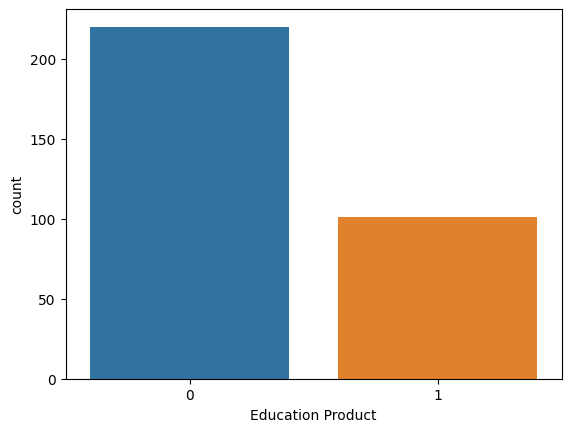

In [ ]:
sns.countplot(data=false_positive_data, x="Education Product")

<Axes: xlabel='Call Center', ylabel='count'>

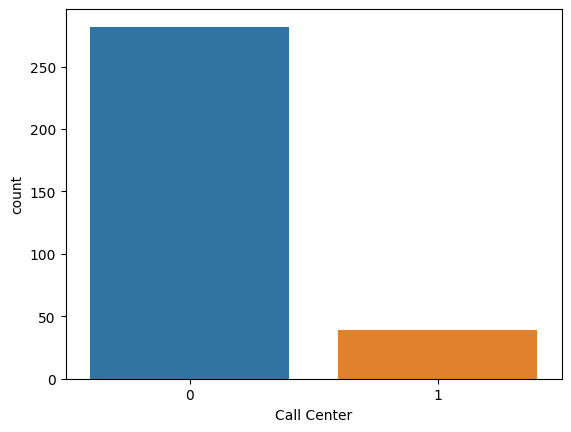

In [ ]:
sns.countplot(data=false_positive_data, x="Call Center")

<Axes: xlabel='Video Product', ylabel='count'>

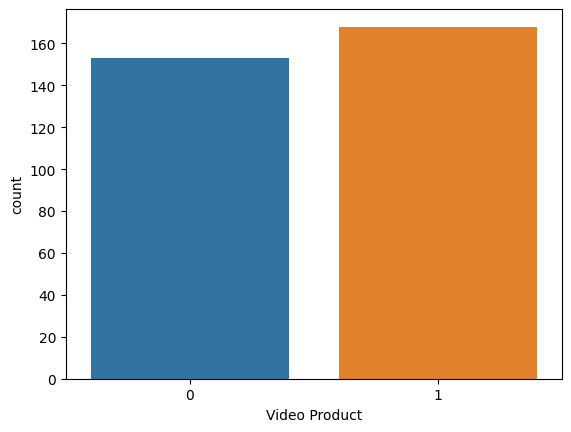

In [ ]:
sns.countplot(data=false_positive_data, x="Video Product")

<Axes: xlabel='Use MyApp', ylabel='count'>

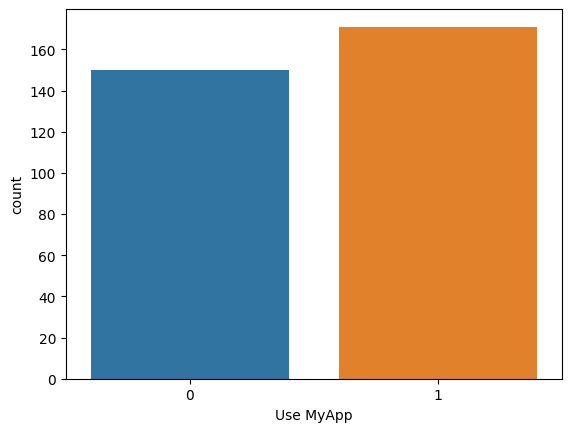

In [ ]:
sns.countplot(data=false_positive_data, x="Use MyApp")

<Axes: xlabel='Payment Method_Credit', ylabel='count'>

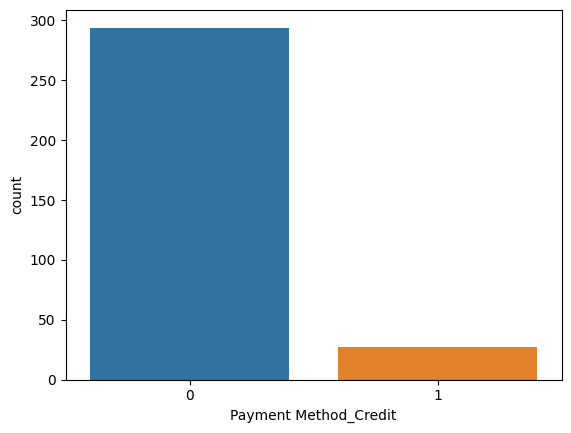

In [ ]:
sns.countplot(data=false_positive_data, x="Payment Method_Credit")

<Axes: xlabel='Payment Method_Debit', ylabel='count'>

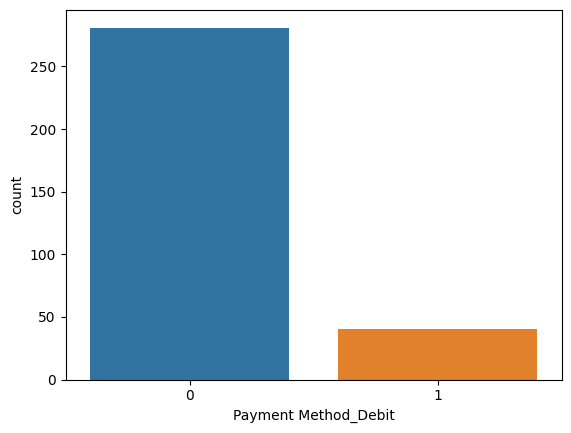

In [ ]:
sns.countplot(data=false_positive_data, x="Payment Method_Debit")

<Axes: xlabel='Payment Method_Digital Wallet', ylabel='count'>

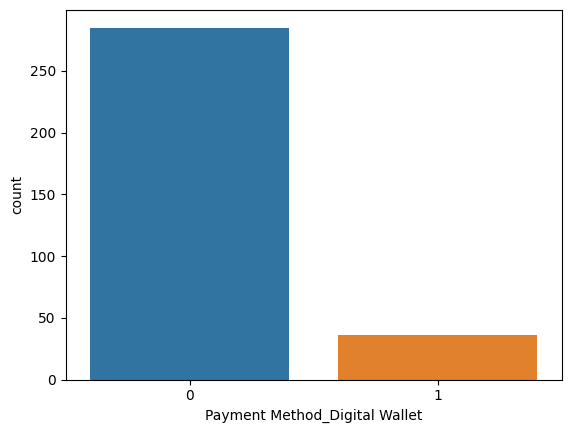

In [ ]:
sns.countplot(data=false_positive_data, x="Payment Method_Digital Wallet")

<Axes: xlabel='Payment Method_Pulsa', ylabel='count'>

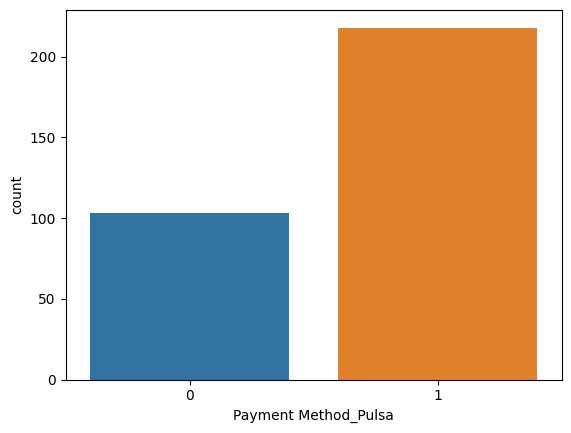

In [ ]:
sns.countplot(data=false_positive_data, x="Payment Method_Pulsa")

# Linear Regression (CLTV)

In [ ]:
df = pd.read_excel('Telco_customer_churn_adapted_v2.xlsx')
df = df.drop(columns=['Longitude', 'Latitude', 'Customer ID'])
#scaler = MinMaxScaler()
#columns_to_normalize = ["Tenure Months","Monthly Purchase (Thou. IDR)","CLTV (Predicted Thou. IDR)"]
#df[columns_to_normalize] = scaler.fit_transform(df[columns_to_normalize])
df = df[df['Games Product'] != 'No internet service']
df[['Games Product','Music Product','Education Product','Call Center','Video Product','Use MyApp','Churn Label']] = (df[['Games Product','Music Product','Education Product','Call Center','Video Product','Use MyApp','Churn Label']] == 'Yes').astype(int)
df['Location'] = (df['Location'] == 'Jakarta').astype(int)
df['Device Class'] = (df['Device Class'] == 'High End').astype(int)
df = pd.get_dummies(df, columns=['Payment Method'])

In [ ]:
X = df.drop(columns=['CLTV (Predicted Thou. IDR)'])
y = df['CLTV (Predicted Thou. IDR)']

In [ ]:
reg = LinearRegression().fit(X, y)

In [ ]:
reg.score(X, y)

0.1684977983552417

In [ ]:
reg.coef_

array([  26.75,    6.29, -111.46,   35.35,  -42.55, -122.47,  -46.  ,
        -60.01,  -20.9 ,    2.57,   18.19,  -37.08,   25.07,  -53.73,
         65.74])

In [ ]:
sfs = SequentialFeatureSelector(LinearRegression(), n_features_to_select='auto')

In [ ]:
sfs.fit(X, y)

SequentialFeatureSelector(estimator=LinearRegression(),
                          n_features_to_select='auto')

In [ ]:
sfs.get_support()

array([ True,  True, False,  True, False,  True, False, False, False,
       False,  True, False,  True, False,  True])

In [ ]:
sfs.get_feature_names_out()

array(['Tenure Months', 'Location', 'Games Product', 'Education Product',
       'Churn Label', 'Payment Method_Debit', 'Payment Method_Pulsa'],
      dtype=object)

In [ ]:
X

,Tenure Months,Location,Device Class,Games Product,Music Product,Education Product,Call Center,Video Product,Use MyApp,Monthly Purchase (Thou. IDR),Churn Label,Payment Method_Credit,Payment Method_Debit,Payment Method_Digital Wallet,Payment Method_Pulsa
0,2,1,0,1,1,0,0,0,0,70.005,1,0,0,1,0
1,2,1,1,0,0,0,0,0,0,91.910,1,0,0,0,1
2,8,1,1,0,0,1,0,1,1,129.545,1,0,0,0,1
3,28,1,1,0,0,1,1,1,1,136.240,1,0,0,0,1
4,49,1,1,0,1,1,0,1,1,134.810,1,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7037,12,1,0,0,1,1,1,1,1,78.845,0,0,0,0,1
7039,24,1,0,1,0,1,1,1,1,110.240,0,0,0,1,0
7040,72,1,1,0,1,1,0,1,1,134.160,0,1,0,0,0
7041,11,1,0,1,0,0,0,0,0,38.480,0,0,0,0,1


In [ ]:
reg = LinearRegression().fit(sfs.transform(X), y)

In [ ]:
reg.score(sfs.transform(X), y)

0.1680776204330282

In [ ]:
reg.coef_

array([  26.47,    7.46,   51.63, -110.98,   19.98,   69.15,  110.64])

# Ridge Regression (CLTV)

In [ ]:
df = pd.read_excel('Telco_customer_churn_adapted_v2.xlsx')
df = df.drop(columns=['Longitude', 'Latitude', 'Customer ID'])
df = df[df['Games Product'] != 'No internet service']
df[['Games Product','Music Product','Education Product','Call Center','Video Product','Use MyApp','Churn Label']] = (df[['Games Product','Music Product','Education Product','Call Center','Video Product','Use MyApp','Churn Label']] == 'Yes').astype(int)
df['Location'] = (df['Location'] == 'Jakarta').astype(int)
df['Device Class'] = (df['Device Class'] == 'High End').astype(int)
df = pd.get_dummies(df, columns=['Payment Method'])

In [ ]:
X = df.drop(columns=['CLTV (Predicted Thou. IDR)'])
y = df['CLTV (Predicted Thou. IDR)']

In [ ]:
reg = Ridge().fit(X, y)

In [ ]:
reg.score(X, y)

0.16849778710655505

In [ ]:
reg.coef_

array([  26.75,    6.29, -110.69,   35.43,  -42.41, -122.27,  -45.84,
        -59.78,  -20.72,    2.56,   18.16,  -37.06,   25.04,  -53.66,
         65.68])

In [ ]:
sfs = SequentialFeatureSelector(Ridge(), n_features_to_select='auto')

In [ ]:
sfs.fit(X, y)

SequentialFeatureSelector(estimator=Ridge(), n_features_to_select='auto')

In [ ]:
sfs.get_feature_names_out()

array(['Tenure Months', 'Location', 'Games Product', 'Education Product',
       'Churn Label', 'Payment Method_Debit', 'Payment Method_Pulsa'],
      dtype=object)

In [ ]:
X

,Tenure Months,Location,Device Class,Games Product,Music Product,Education Product,Call Center,Video Product,Use MyApp,Monthly Purchase (Thou. IDR),Churn Label,Payment Method_Credit,Payment Method_Debit,Payment Method_Digital Wallet,Payment Method_Pulsa
0,2,1,0,1,1,0,0,0,0,70.005,1,0,0,1,0
1,2,1,1,0,0,0,0,0,0,91.910,1,0,0,0,1
2,8,1,1,0,0,1,0,1,1,129.545,1,0,0,0,1
3,28,1,1,0,0,1,1,1,1,136.240,1,0,0,0,1
4,49,1,1,0,1,1,0,1,1,134.810,1,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7037,12,1,0,0,1,1,1,1,1,78.845,0,0,0,0,1
7039,24,1,0,1,0,1,1,1,1,110.240,0,0,0,1,0
7040,72,1,1,0,1,1,0,1,1,134.160,0,1,0,0,0
7041,11,1,0,1,0,0,0,0,0,38.480,0,0,0,0,1


In [ ]:
reg = Ridge().fit(sfs.transform(X), y)

In [ ]:
reg.score(sfs.transform(X), y)

0.1680776173205798

In [ ]:
reg.coef_

array([  26.47,    7.45,   51.56, -110.88,   19.98,   69.01,  110.49])

# Multiple Regression (CLTV)

In [ ]:
df = pd.read_excel('Telco_customer_churn_adapted_v2.xlsx')
df = df.drop(columns=['Longitude', 'Latitude', 'Customer ID'])
scaler = MinMaxScaler()
columns_to_normalize = ["Tenure Months","Monthly Purchase (Thou. IDR)","CLTV (Predicted Thou. IDR)"]
df[columns_to_normalize] = scaler.fit_transform(df[columns_to_normalize])
df = df[df['Games Product'] != 'No internet service']
df[['Games Product','Music Product','Education Product','Call Center','Video Product','Use MyApp','Churn Label']] = (df[['Games Product','Music Product','Education Product','Call Center','Video Product','Use MyApp','Churn Label']] == 'Yes').astype(int)
df['Location'] = (df['Location'] == 'Jakarta').astype(int)
df['Device Class'] = (df['Device Class'] == 'High End').astype(int)
df = pd.get_dummies(df, columns=['Payment Method'])

In [ ]:
X = df.drop(columns=['CLTV (Predicted Thou. IDR)'])
y = df['CLTV (Predicted Thou. IDR)']

In [ ]:
models = [
    LinearRegression(),
    Ridge(),
    Lasso(),
    RandomForestRegressor(),
    SVR(),
    KNeighborsRegressor(),
    DecisionTreeRegressor(),
    GradientBoostingRegressor()
]

In [ ]:
for model in models:
    scores = cross_val_score(model, X, y, cv=5, scoring='neg_mean_squared_error')
    rmse_scores = [(-score) ** 0.5 for score in scores]
    print(f"{model.__class__.__name__}: RMSE = {np.mean(rmse_scores)} (±{np.std(rmse_scores)})")

LinearRegression: RMSE = 0.2404282831702793 (±0.012988612021381924)
Ridge: RMSE = 0.2402527082525737 (±0.013112066444897784)
Lasso: RMSE = 0.2644053895371246 (±0.007266006765486992)
RandomForestRegressor: RMSE = 0.24518525307398495 (±0.01673308182920174)
SVR: RMSE = 0.2524417460796199 (±0.01404046726270605)
KNeighborsRegressor: RMSE = 0.26524084927746705 (±0.012110036029352938)
DecisionTreeRegressor: RMSE = 0.32934269190079923 (±0.019439962817854)
GradientBoostingRegressor: RMSE = 0.23241237418803254 (±0.014307120414333905)


In [ ]:
for model in models:
    scores = cross_val_score(model, X, y, cv=5, scoring='r2')
    rsquared_scores = [score for score in scores]
    print(f"{model.__class__.__name__}: R squared = {np.mean(rsquared_scores)} (±{np.std(rsquared_scores)})")

LinearRegression: R squared = 0.14778731602100173 (±0.06360857468108068)
Ridge: R squared = 0.14902479527405593 (±0.06430519985876552)
Lasso: R squared = -0.0304358075061252 (±0.026333804774861067)
RandomForestRegressor: R squared = 0.11317434841960697 (±0.08878403870598917)
SVR: R squared = 0.05986686442473617 (±0.08114567516336184)
KNeighborsRegressor: R squared = -0.036760669105634226 (±0.055938562952337935)
DecisionTreeRegressor: R squared = -0.6132986247251088 (±0.1482251070350325)
GradientBoostingRegressor: R squared = 0.20353137196891224 (±0.07160816877671268)


In [ ]:
models = [
    MLPRegressor(),
    XGBRegressor(),
    LGBMRegressor(),
    CatBoostRegressor()
]

In [ ]:
model_scores = {}
for model in models:
    scores = cross_val_score(model, X, y, scoring='neg_mean_squared_error', cv=5)
    rmse_scores = [(-score) ** 0.5 for score in scores]
    model_scores[type(model).__name__] = rmse_scores

Streaming output truncated to the last 5000 lines.
4:	learn: 0.2471981	total: 78.6ms	remaining: 15.6s
5:	learn: 0.2450666	total: 84.5ms	remaining: 14s
6:	learn: 0.2431303	total: 88.1ms	remaining: 12.5s
7:	learn: 0.2414452	total: 94.8ms	remaining: 11.8s
8:	learn: 0.2397924	total: 98.5ms	remaining: 10.8s
9:	learn: 0.2384135	total: 103ms	remaining: 10.2s
10:	learn: 0.2370518	total: 108ms	remaining: 9.73s
11:	learn: 0.2359220	total: 109ms	remaining: 9.01s
12:	learn: 0.2349061	total: 110ms	remaining: 8.37s
13:	learn: 0.2338643	total: 112ms	remaining: 7.89s
14:	learn: 0.2329125	total: 114ms	remaining: 7.51s
15:	learn: 0.2321676	total: 115ms	remaining: 7.08s
16:	learn: 0.2314193	total: 117ms	remaining: 6.76s
17:	learn: 0.2307749	total: 119ms	remaining: 6.47s
18:	learn: 0.2301444	total: 119ms	remaining: 6.17s
19:	learn: 0.2295159	total: 121ms	remaining: 5.94s
20:	learn: 0.2289432	total: 123ms	remaining: 5.72s
21:	learn: 0.2284326	total: 125ms	remaining: 5.55s
22:	learn: 0.2279512	total: 127ms	

In [ ]:
for model_name, rmse_scores in model_scores.items():
   print(f'{model_name}: RMSE = {np.mean(rmse_scores)} (±{np.std(rmse_scores)})')

MLPRegressor: RMSE = 0.24357809490896115 (±0.012564269778612214)
XGBRegressor: RMSE = 0.2574820059769162 (±0.01702427692451462)
LGBMRegressor: RMSE = 0.2390817879271904 (±0.013658876624789349)
CatBoostRegressor: RMSE = 0.24061320011423035 (±0.015223845501427705)


In [ ]:
model_scores = {}
for model in models:
    scores = cross_val_score(model, X, y, scoring='r2', cv=5)
    rsquared_scores = [score for score in scores]
    model_scores[type(model).__name__] = rsquared_scores

Streaming output truncated to the last 5000 lines.
4:	learn: 0.2471981	total: 10.3ms	remaining: 2.06s
5:	learn: 0.2450666	total: 12.1ms	remaining: 2.01s
6:	learn: 0.2431303	total: 13.7ms	remaining: 1.95s
7:	learn: 0.2414452	total: 15.2ms	remaining: 1.89s
8:	learn: 0.2397924	total: 16.6ms	remaining: 1.83s
9:	learn: 0.2384135	total: 18.2ms	remaining: 1.8s
10:	learn: 0.2370518	total: 19.7ms	remaining: 1.77s
11:	learn: 0.2359220	total: 20.9ms	remaining: 1.72s
12:	learn: 0.2349061	total: 21.6ms	remaining: 1.64s
13:	learn: 0.2338643	total: 23.2ms	remaining: 1.63s
14:	learn: 0.2329125	total: 24.8ms	remaining: 1.63s
15:	learn: 0.2321676	total: 25.5ms	remaining: 1.57s
16:	learn: 0.2314193	total: 27ms	remaining: 1.56s
17:	learn: 0.2307749	total: 28.5ms	remaining: 1.55s
18:	learn: 0.2301444	total: 29.3ms	remaining: 1.51s
19:	learn: 0.2295159	total: 30.9ms	remaining: 1.51s
20:	learn: 0.2289432	total: 32.4ms	remaining: 1.51s
21:	learn: 0.2284326	total: 34ms	remaining: 1.51s
22:	learn: 0.2279512	tot

In [ ]:
for model_name, rsquared_scores in model_scores.items():
   print(f'{model_name}: R Squared = {np.mean(rsquared_scores)} (±{np.std(rsquared_scores)})')

MLPRegressor: R Squared = 0.1243998339213093 (±0.06829009553737934)
XGBRegressor: R Squared = 0.021922373180371137 (±0.0982451253213999)
LGBMRegressor: R Squared = 0.15725754968078676 (±0.0672970315242686)
CatBoostRegressor: R Squared = 0.14596987640073708 (±0.0815732591837323)


In [ ]:
reg = GradientBoostingRegressor().fit(X, y)

In [ ]:
reg.score(X, y)

0.2779956219223991

In [ ]:
df = pd.read_excel('Telco_customer_churn_adapted_v2.xlsx')
max_vals = df['CLTV (Predicted Thou. IDR)'].max()
min_vals = df['CLTV (Predicted Thou. IDR)'].min()
unnormalized_rmse = (0.23241237418803254 * (max_vals - min_vals)) + min_vals

In [ ]:
unnormalized_rmse

3962.6059807406573

In [ ]:
filename = 'CLTV_model.sav'
pickle.dump(reg, open(filename, 'wb'))